# Session (466029_f3_stage2_day9)

# Processing of Raw Calcium Cortical Data into dFF tiff Stacks

In [1]:
"""install the packages to run this code"""
#%pip install matplotlib tifffile scipy tqdm pybaselines opencv-python imagecodecs pickle #plotly #need to do this through conda install

'install the packages to run this code'

In [2]:
session = "466029_f3_stage2_day9" #cageID_mouseID_stage_day

## Step 1: importing the proper libraries

note: all packaged are compatible with Python 3.12 as of 2024, Feb 22

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import cv2
from scipy import interpolate
from scipy.interpolate import interp1d
from scipy.ndimage import gaussian_filter
from scipy.signal import cheby1, filtfilt, find_peaks, peak_widths
import scipy
from tqdm import tqdm
%matplotlib inline
import plotly.express as px
import imagecodecs
from matplotlib.animation import FuncAnimation
import pickle
from pybaselines import Baseline
import pandas as pd
from ipywidgets import interact, FloatSlider
import matplotlib.gridspec as gridspec

from preprocessing_functions import (load_frames, 
                                        interactive_plot, 
                                        plot_frame, 
                                        temporal_mean, 
                                        remove_dark_frames, 
                                        extract_artifacts, 
                                        interpolate, 
                                        dff, 
                                        smoothing, 
                                        save_tiff,
                                        load_txt,
                                        extract_txt_flashes,
                                        load_masks, 
                                        avg_trials,
                                        extract_v1,
                                        animate_figure, 
extract_success,
sort_success,
extract_nogo)

## Step 2: importing and exporting from the script

### 2A: Manual importing data and paths

Please insert the file path for the tif stack as a 3d array

In [4]:
missing_artifacts = "FALSE"

In [5]:
cohort = "3_third_cohort"

### 2B: Manual Exporting data path

In [6]:
parts = session.split("_") # Split the string by underscores

cageID_mouseID = f"{parts[0]}_{parts[1]}" #cageID_mouseID
cageID, mouseID = parts[0], parts[1] #newv2
day = parts[3]  # what day of the stage they are in

print(f"cageID_mouseID = \"{cageID_mouseID}\"")
print(f"day = \"{day}\"")

cageID_mouseID = "466029_f3"
day = "day9"


### 2C: autonomous loadings and exporting lines !do not need to manipulate!

#### 2C.1: loading frames in

In [7]:
common_cortical_path = "X:/RaymondLab/1_Kai/1_cortical_data/"

In [8]:
video = f"{common_cortical_path}/{cohort}/stage2/{session}.tif"

In [9]:
frame_number = 6000 #please insert frame number to view
frames = load_frames(video); #loading in tif stack, this will take a little while

loading video, please wait...


dimensions are (35235, 128, 128) as a uint16


#### 2C.2: Tiff stack (spatial view videos) export

make sure folders exists: files are organized by common_tiff_path -> stage -> day -> full,single,double -> File_name(cage_mouseid_stage_day_condition)

In [10]:
common_tiff_path = "X:/RaymondLab/1_Kai/3_processed_data/1_tiff_stacks/stage2/"

In [11]:
tiff_path_full = f"{common_tiff_path}{day}/full_frame/{cageID_mouseID}_stage2_{day}_full_frame.tiff"
tiff_path_single = f"{common_tiff_path}{day}/single/{cageID_mouseID}_stage2_{day}_single.tiff"
tiff_path_double = f"{common_tiff_path}{day}/double/{cageID_mouseID}_stage2_{day}_double.tiff"

#### 2C.3: Pickle export timeseries array

make sure folders exist: files are organized by common_pickle_path -> stage -> day -> single,double -> ROI -> File_name(cage_mouseid_stage_day_condition)

In [12]:
common_pickle_path = "X:/RaymondLab/1_Kai/3_processed_data/2_pickle/stage2/"

In [13]:
pickle_single_v1 = f"{common_pickle_path}{day}/single/v1/{cageID_mouseID}_stage2_{day}_single_v1.pickle"
pickle_double_v1 = f"{common_pickle_path}{day}/double/v1/{cageID_mouseID}_stage2_{day}_double_v1.pickle"

pickle_single_success_ff = f"{common_pickle_path}single/success/full_frame/{cageID_mouseID}_stage2_{day}_single_success_ff.pickle"
pickle_double_success_ff = f"{common_pickle_path}double/success/full_frame/{cageID_mouseID}_stage2_{day}_double_success_ff.pickle"
pickle_nogo_success_ff = f"{common_pickle_path}nogo/success/full_frame/{cageID_mouseID}_stage2_{day}_nogo_success_ff.pickle"

pickle_single_fail_ff = f"{common_pickle_path}single/fail/full_frame/{cageID_mouseID}_stage2_{day}_single_fail_ff.pickle"
pickle_double_fail_ff = f"{common_pickle_path}double/fail/full_frame/{cageID_mouseID}_stage2_{day}_double_fail_ff.pickle"
pickle_nogo_fail_ff = f"{common_pickle_path}nogo/fail/full_frame/{cageID_mouseID}_stage2_{day}_nogo_fail_ff.pickle"

## Step 3: Plot of Raw Frames and Timecourse

### 3A: Plotting raw frame example, to make sure the tif stack loaded in properly.


Make sure the frames are a 3d array, two figures will be generated, a greyscaled and colormapped. They are technically identical

frame number 6000 plotted


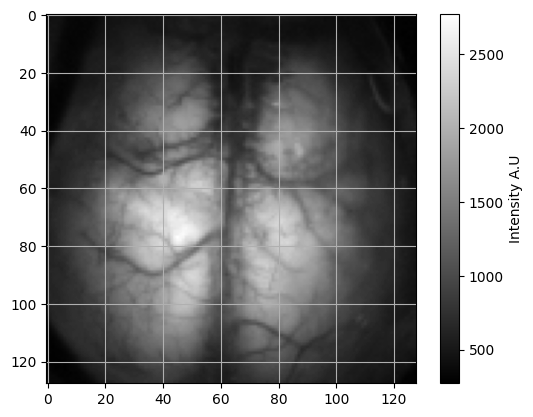

frame number 6000 plotted


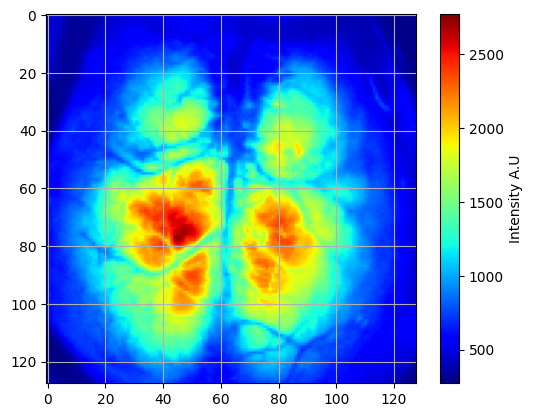

In [14]:
plot_frame(frames, frame_number, cmap = 'grey', color_label = "Intensity A.U")
plot_frame(frames, frame_number, cmap = 'jet', color_label = "Intensity A.U")

### 3B: Plot of the raw signal mean for each frame over the length of the experiment

Mean time course of the raw signal

In [15]:
mean_timecourse = temporal_mean(frames);

default 20% threshold is 264.381005859375 Determine if adjustments need to be made


## Step 4: Mean Timecourse without Darkframes at Start and End

#### 4A: plot of timecourse

#### 4B: number of single and double flashes as well as total number.

In [16]:
darkf_removed = remove_dark_frames(frames, mean_timecourse, 0.35)
darkf_removed_timecourse, darkf_removed_frames = darkf_removed[0], darkf_removed[1] #first one is the timecourse with no 3d, second is the 3d array

threshold determined to be: 297.4286315917969


#### 4C: pybaselines (only run if missing flashes)

In [17]:
if missing_artifacts == "TRUE":
    x = np.linspace(0, len(darkf_removed_timecourse), len(darkf_removed_timecourse))
    baseline_fitter = Baseline(x_data=x)

    smoothed_imodpoly = baseline_fitter.imodpoly(darkf_removed_timecourse, poly_order=3, num_std=0.7)[0]
    flattened = darkf_removed_timecourse-smoothed_imodpoly

    artifacts = extract_artifacts(flattened)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

    #plotting moving mean and signal
    fig = px.line(y = [flattened])
    fig.update_layout(
    title= "mean timecourse with moving average overlay",
    xaxis=dict(title="frame number (30 fps)"),
    yaxis=dict(title="intensity value (A.U)"),
    xaxis_rangeslider_visible=True,
    showlegend=True)

    fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

    fig.show()

    plt.figure()
    plt.plot(darkf_removed_timecourse, label='Subset Signal')
    plt.plot(smoothed_imodpoly, '--', label='Smoothed imodpoly')
    plt.legend()
    plt.show()

!! If the total does not match the single and double combined, check dataset!!

In [18]:
if missing_artifacts == "FALSE": #newv2
    artifacts = extract_artifacts(darkf_removed_timecourse)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

Number of double_flash: 90
Number of double_flash pairs: 45
Number of single_flash: 32
Number of total flashes: 122


## Step 5: Artifact Removal and DFF

### 5A: Plot of mean timecourse with artifacts removed


plot is generated with interpolated frames where the artifacts were, approximately 5 frames

In [19]:
no_artifact_timecourse = interpolate(darkf_removed_frames, artifact_indices, 5)

interpolating artifact frames...


  0%|                                                                                          | 0/122 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/122 [00:01<02:38,  1.31s/it]

  2%|█▎                                                                                | 2/122 [00:02<02:34,  1.29s/it]

  2%|██                                                                                | 3/122 [00:03<02:36,  1.32s/it]

  3%|██▋                                                                               | 4/122 [00:05<02:33,  1.30s/it]

  4%|███▎                                                                              | 5/122 [00:06<02:34,  1.32s/it]

  5%|████                                                                              | 6/122 [00:08<02:40,  1.38s/it]

  6%|████▋                                                                             | 7/122 [00:09<02:37,  1.37s/it]

  7%|█████▍                                                                            | 8/122 [00:10<02:37,  1.38s/it]

  7%|██████                                                                            | 9/122 [00:12<02:32,  1.35s/it]

  8%|██████▋                                                                          | 10/122 [00:13<02:32,  1.36s/it]

  9%|███████▎                                                                         | 11/122 [00:14<02:30,  1.36s/it]

 10%|███████▉                                                                         | 12/122 [00:16<02:27,  1.34s/it]

 11%|████████▋                                                                        | 13/122 [00:17<02:27,  1.35s/it]

 11%|█████████▎                                                                       | 14/122 [00:18<02:29,  1.39s/it]

 12%|█████████▉                                                                       | 15/122 [00:20<02:27,  1.38s/it]

 13%|██████████▌                                                                      | 16/122 [00:21<02:25,  1.37s/it]

 14%|███████████▎                                                                     | 17/122 [00:23<02:26,  1.39s/it]

 15%|███████████▉                                                                     | 18/122 [00:24<02:26,  1.41s/it]

 16%|████████████▌                                                                    | 19/122 [00:25<02:24,  1.40s/it]

 16%|█████████████▎                                                                   | 20/122 [00:27<02:22,  1.40s/it]

 17%|█████████████▉                                                                   | 21/122 [00:28<02:20,  1.39s/it]

 18%|██████████████▌                                                                  | 22/122 [00:30<02:18,  1.39s/it]

 19%|███████████████▎                                                                 | 23/122 [00:31<02:17,  1.38s/it]

 20%|███████████████▉                                                                 | 24/122 [00:32<02:14,  1.37s/it]

 20%|████████████████▌                                                                | 25/122 [00:34<02:12,  1.37s/it]

 21%|█████████████████▎                                                               | 26/122 [00:35<02:10,  1.35s/it]

 22%|█████████████████▉                                                               | 27/122 [00:36<02:08,  1.35s/it]

 23%|██████████████████▌                                                              | 28/122 [00:38<02:09,  1.38s/it]

 24%|███████████████████▎                                                             | 29/122 [00:39<02:05,  1.35s/it]

 25%|███████████████████▉                                                             | 30/122 [00:40<02:05,  1.37s/it]

 25%|████████████████████▌                                                            | 31/122 [00:42<02:04,  1.37s/it]

 26%|█████████████████████▏                                                           | 32/122 [00:43<02:00,  1.34s/it]

 27%|█████████████████████▉                                                           | 33/122 [00:44<01:58,  1.33s/it]

 28%|██████████████████████▌                                                          | 34/122 [00:46<01:56,  1.33s/it]

 29%|███████████████████████▏                                                         | 35/122 [00:47<01:54,  1.32s/it]

 30%|███████████████████████▉                                                         | 36/122 [00:49<01:57,  1.36s/it]

 30%|████████████████████████▌                                                        | 37/122 [00:50<01:53,  1.34s/it]

 31%|█████████████████████████▏                                                       | 38/122 [00:51<01:53,  1.35s/it]

 32%|█████████████████████████▉                                                       | 39/122 [00:52<01:50,  1.33s/it]

 33%|██████████████████████████▌                                                      | 40/122 [00:54<01:50,  1.35s/it]

 34%|███████████████████████████▏                                                     | 41/122 [00:55<01:50,  1.36s/it]

 34%|███████████████████████████▉                                                     | 42/122 [00:57<01:47,  1.34s/it]

 35%|████████████████████████████▌                                                    | 43/122 [00:58<01:47,  1.36s/it]

 36%|█████████████████████████████▏                                                   | 44/122 [00:59<01:46,  1.36s/it]

 37%|█████████████████████████████▉                                                   | 45/122 [01:01<01:45,  1.37s/it]

 38%|██████████████████████████████▌                                                  | 46/122 [01:02<01:44,  1.37s/it]

 39%|███████████████████████████████▏                                                 | 47/122 [01:04<01:43,  1.39s/it]

 39%|███████████████████████████████▊                                                 | 48/122 [01:05<01:41,  1.38s/it]

 40%|████████████████████████████████▌                                                | 49/122 [01:06<01:41,  1.39s/it]

 41%|█████████████████████████████████▏                                               | 50/122 [01:08<01:39,  1.38s/it]

 42%|█████████████████████████████████▊                                               | 51/122 [01:09<01:38,  1.38s/it]

 43%|██████████████████████████████████▌                                              | 52/122 [01:10<01:37,  1.39s/it]

 43%|███████████████████████████████████▏                                             | 53/122 [01:12<01:34,  1.37s/it]

 44%|███████████████████████████████████▊                                             | 54/122 [01:13<01:32,  1.35s/it]

 45%|████████████████████████████████████▌                                            | 55/122 [01:14<01:31,  1.37s/it]

 46%|█████████████████████████████████████▏                                           | 56/122 [01:16<01:29,  1.36s/it]

 47%|█████████████████████████████████████▊                                           | 57/122 [01:17<01:26,  1.32s/it]

 48%|██████████████████████████████████████▌                                          | 58/122 [01:18<01:25,  1.33s/it]

 48%|███████████████████████████████████████▏                                         | 59/122 [01:20<01:23,  1.32s/it]

 49%|███████████████████████████████████████▊                                         | 60/122 [01:21<01:21,  1.32s/it]

 50%|████████████████████████████████████████▌                                        | 61/122 [01:22<01:22,  1.35s/it]

 51%|█████████████████████████████████████████▏                                       | 62/122 [01:24<01:21,  1.35s/it]

 52%|█████████████████████████████████████████▊                                       | 63/122 [01:25<01:19,  1.35s/it]

 52%|██████████████████████████████████████████▍                                      | 64/122 [01:27<01:18,  1.36s/it]

 53%|███████████████████████████████████████████▏                                     | 65/122 [01:28<01:16,  1.34s/it]

 54%|███████████████████████████████████████████▊                                     | 66/122 [01:29<01:15,  1.34s/it]

 55%|████████████████████████████████████████████▍                                    | 67/122 [01:31<01:14,  1.36s/it]

 56%|█████████████████████████████████████████████▏                                   | 68/122 [01:32<01:13,  1.36s/it]

 57%|█████████████████████████████████████████████▊                                   | 69/122 [01:33<01:11,  1.34s/it]

 57%|██████████████████████████████████████████████▍                                  | 70/122 [01:35<01:10,  1.35s/it]

 58%|███████████████████████████████████████████████▏                                 | 71/122 [01:36<01:07,  1.33s/it]

 59%|███████████████████████████████████████████████▊                                 | 72/122 [01:37<01:07,  1.34s/it]

 60%|████████████████████████████████████████████████▍                                | 73/122 [01:39<01:06,  1.35s/it]

 61%|█████████████████████████████████████████████████▏                               | 74/122 [01:40<01:05,  1.36s/it]

 61%|█████████████████████████████████████████████████▊                               | 75/122 [01:41<01:03,  1.35s/it]

 62%|██████████████████████████████████████████████████▍                              | 76/122 [01:43<01:02,  1.36s/it]

 63%|███████████████████████████████████████████████████                              | 77/122 [01:44<01:00,  1.34s/it]

 64%|███████████████████████████████████████████████████▊                             | 78/122 [01:45<00:59,  1.35s/it]

 65%|████████████████████████████████████████████████████▍                            | 79/122 [01:47<00:57,  1.35s/it]

 66%|█████████████████████████████████████████████████████                            | 80/122 [01:48<00:57,  1.38s/it]

 66%|█████████████████████████████████████████████████████▊                           | 81/122 [01:50<00:56,  1.38s/it]

 67%|██████████████████████████████████████████████████████▍                          | 82/122 [01:51<00:55,  1.39s/it]

 68%|███████████████████████████████████████████████████████                          | 83/122 [01:52<00:54,  1.40s/it]

 69%|███████████████████████████████████████████████████████▊                         | 84/122 [01:54<00:54,  1.43s/it]

 70%|████████████████████████████████████████████████████████▍                        | 85/122 [01:55<00:51,  1.40s/it]

 70%|█████████████████████████████████████████████████████████                        | 86/122 [01:56<00:48,  1.34s/it]

 71%|█████████████████████████████████████████████████████████▊                       | 87/122 [01:58<00:46,  1.32s/it]

 72%|██████████████████████████████████████████████████████████▍                      | 88/122 [01:59<00:45,  1.33s/it]

 73%|███████████████████████████████████████████████████████████                      | 89/122 [02:00<00:43,  1.33s/it]

 74%|███████████████████████████████████████████████████████████▊                     | 90/122 [02:02<00:43,  1.36s/it]

 75%|████████████████████████████████████████████████████████████▍                    | 91/122 [02:03<00:41,  1.34s/it]

 75%|█████████████████████████████████████████████████████████████                    | 92/122 [02:04<00:40,  1.35s/it]

 76%|█████████████████████████████████████████████████████████████▋                   | 93/122 [02:06<00:39,  1.35s/it]

 77%|██████████████████████████████████████████████████████████████▍                  | 94/122 [02:07<00:39,  1.40s/it]

 78%|███████████████████████████████████████████████████████████████                  | 95/122 [02:09<00:36,  1.36s/it]

 79%|███████████████████████████████████████████████████████████████▋                 | 96/122 [02:10<00:34,  1.34s/it]

 80%|████████████████████████████████████████████████████████████████▍                | 97/122 [02:11<00:33,  1.34s/it]

 80%|█████████████████████████████████████████████████████████████████                | 98/122 [02:12<00:31,  1.31s/it]

 81%|█████████████████████████████████████████████████████████████████▋               | 99/122 [02:14<00:30,  1.31s/it]

 82%|█████████████████████████████████████████████████████████████████▌              | 100/122 [02:15<00:29,  1.35s/it]

 83%|██████████████████████████████████████████████████████████████████▏             | 101/122 [02:17<00:28,  1.34s/it]

 84%|██████████████████████████████████████████████████████████████████▉             | 102/122 [02:18<00:26,  1.33s/it]

 84%|███████████████████████████████████████████████████████████████████▌            | 103/122 [02:19<00:24,  1.31s/it]

 85%|████████████████████████████████████████████████████████████████████▏           | 104/122 [02:20<00:23,  1.31s/it]

 86%|████████████████████████████████████████████████████████████████████▊           | 105/122 [02:22<00:22,  1.32s/it]

 87%|█████████████████████████████████████████████████████████████████████▌          | 106/122 [02:23<00:21,  1.31s/it]

 88%|██████████████████████████████████████████████████████████████████████▏         | 107/122 [02:24<00:19,  1.31s/it]

 89%|██████████████████████████████████████████████████████████████████████▊         | 108/122 [02:26<00:18,  1.31s/it]

 89%|███████████████████████████████████████████████████████████████████████▍        | 109/122 [02:27<00:16,  1.31s/it]

 90%|████████████████████████████████████████████████████████████████████████▏       | 110/122 [02:28<00:16,  1.34s/it]

 91%|████████████████████████████████████████████████████████████████████████▊       | 111/122 [02:30<00:14,  1.35s/it]

 92%|█████████████████████████████████████████████████████████████████████████▍      | 112/122 [02:31<00:13,  1.35s/it]

 93%|██████████████████████████████████████████████████████████████████████████      | 113/122 [02:32<00:11,  1.32s/it]

 93%|██████████████████████████████████████████████████████████████████████████▊     | 114/122 [02:34<00:10,  1.32s/it]

 94%|███████████████████████████████████████████████████████████████████████████▍    | 115/122 [02:35<00:09,  1.36s/it]

 95%|████████████████████████████████████████████████████████████████████████████    | 116/122 [02:36<00:08,  1.34s/it]

 96%|████████████████████████████████████████████████████████████████████████████▋   | 117/122 [02:38<00:06,  1.31s/it]

 97%|█████████████████████████████████████████████████████████████████████████████▍  | 118/122 [02:39<00:05,  1.32s/it]

 98%|██████████████████████████████████████████████████████████████████████████████  | 119/122 [02:40<00:04,  1.35s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▋ | 120/122 [02:42<00:02,  1.37s/it]

 99%|███████████████████████████████████████████████████████████████████████████████▎| 121/122 [02:43<00:01,  1.41s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 122/122 [02:45<00:00,  1.39s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 122/122 [02:45<00:00,  1.35s/it]

### 5B: Calculating dff


Dff calculated from the 3d array without artifacts, darkframes removed, and interpolated the space where the artifacts were. Then plotting of the signal with the 10s moving mean before dff is applied. dff is applied using this moving mean onto the signal

In [20]:
dff_array = dff(no_artifact_timecourse, 10, 30);
dff_signal, moving_average = dff_array[0], dff_array[1]

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

 22%|█████████████████▌                                                              | 28/128 [00:00<00:00, 276.38it/s]

 44%|███████████████████████████████████                                             | 56/128 [00:00<00:00, 247.88it/s]

 63%|██████████████████████████████████████████████████▋                             | 81/128 [00:00<00:00, 236.87it/s]

 82%|████████████████████████████████████████████████████████████████▊              | 105/128 [00:00<00:00, 226.55it/s]

100%|███████████████████████████████████████████████████████████████████████████████| 128/128 [00:00<00:00, 223.27it/s]

100%|███████████████████████████████████████████████████████████████████████████████| 128/128 [00:00<00:00, 230.23it/s]

  0%|                                                                                        | 0/34374 [00:00<?, ?it/s]

  0%|                                                                              | 27/34374 [00:00<02:08, 267.42it/s]

  0%|                                                                              | 54/34374 [00:00<02:09, 265.87it/s]

  0%|▏                                                                             | 81/34374 [00:00<02:09, 265.38it/s]

  0%|▏                                                                            | 108/34374 [00:00<02:19, 245.19it/s]

  0%|▎                                                                            | 133/34374 [00:00<02:22, 240.34it/s]

  0%|▎                                                                            | 160/34374 [00:00<02:18, 247.49it/s]

  1%|▍                                                                            | 185/34374 [00:00<02:18, 246.76it/s]

  1%|▍                                                                            | 210/34374 [00:00<02:28, 229.47it/s]

  1%|▌                                                                            | 236/34374 [00:00<02:23, 237.63it/s]

  1%|▌                                                                            | 262/34374 [00:01<02:20, 243.46it/s]

  1%|▋                                                                            | 288/34374 [00:01<02:18, 246.89it/s]

  1%|▋                                                                            | 313/34374 [00:01<02:23, 237.36it/s]

  1%|▊                                                                            | 340/34374 [00:01<02:18, 245.34it/s]

  1%|▊                                                                            | 367/34374 [00:01<02:16, 249.62it/s]

  1%|▉                                                                            | 393/34374 [00:01<02:14, 251.93it/s]

  1%|▉                                                                            | 420/34374 [00:01<02:12, 255.74it/s]

  1%|█                                                                            | 448/34374 [00:01<02:10, 259.84it/s]

  1%|█                                                                            | 476/34374 [00:01<02:07, 265.00it/s]

  1%|█▏                                                                           | 504/34374 [00:02<02:07, 266.31it/s]

  2%|█▏                                                                           | 531/34374 [00:02<02:13, 252.58it/s]

  2%|█▎                                                                           | 559/34374 [00:02<02:10, 258.19it/s]

  2%|█▎                                                                           | 587/34374 [00:02<02:08, 263.33it/s]

  2%|█▍                                                                           | 615/34374 [00:02<02:06, 266.64it/s]

  2%|█▍                                                                           | 643/34374 [00:02<02:06, 267.45it/s]

  2%|█▌                                                                           | 670/34374 [00:02<02:06, 267.44it/s]

  2%|█▌                                                                           | 698/34374 [00:02<02:05, 268.89it/s]

  2%|█▋                                                                           | 726/34374 [00:02<02:04, 269.80it/s]

  2%|█▋                                                                           | 754/34374 [00:02<02:03, 271.23it/s]

  2%|█▊                                                                           | 782/34374 [00:03<02:03, 272.24it/s]

  2%|█▊                                                                           | 810/34374 [00:03<02:05, 266.69it/s]

  2%|█▊                                                                           | 837/34374 [00:03<02:12, 252.99it/s]

  3%|█▉                                                                           | 863/34374 [00:03<02:12, 252.85it/s]

  3%|█▉                                                                           | 889/34374 [00:03<02:20, 237.95it/s]

  3%|██                                                                           | 916/34374 [00:03<02:16, 245.45it/s]

  3%|██                                                                           | 944/34374 [00:03<02:12, 253.06it/s]

  3%|██▏                                                                          | 970/34374 [00:03<02:13, 250.78it/s]

  3%|██▏                                                                          | 996/34374 [00:03<02:13, 249.17it/s]

  3%|██▎                                                                         | 1022/34374 [00:04<02:15, 246.64it/s]

  3%|██▎                                                                         | 1049/34374 [00:04<02:12, 251.90it/s]

  3%|██▍                                                                         | 1075/34374 [00:04<02:19, 238.43it/s]

  3%|██▍                                                                         | 1100/34374 [00:04<02:21, 234.49it/s]

  3%|██▍                                                                         | 1125/34374 [00:04<02:19, 238.17it/s]

  3%|██▌                                                                         | 1152/34374 [00:04<02:15, 245.16it/s]

  3%|██▌                                                                         | 1177/34374 [00:04<02:15, 245.16it/s]

  3%|██▋                                                                         | 1202/34374 [00:04<02:16, 243.07it/s]

  4%|██▋                                                                         | 1227/34374 [00:04<02:23, 231.68it/s]

  4%|██▊                                                                         | 1251/34374 [00:05<02:24, 228.89it/s]

  4%|██▊                                                                         | 1274/34374 [00:05<02:27, 224.17it/s]

  4%|██▉                                                                         | 1301/34374 [00:05<02:21, 234.50it/s]

  4%|██▉                                                                         | 1328/34374 [00:05<02:15, 243.27it/s]

  4%|██▉                                                                         | 1353/34374 [00:05<02:16, 241.40it/s]

  4%|███                                                                         | 1378/34374 [00:05<02:17, 240.44it/s]

  4%|███                                                                         | 1405/34374 [00:05<02:13, 246.69it/s]

  4%|███▏                                                                        | 1431/34374 [00:05<02:11, 250.08it/s]

  4%|███▏                                                                        | 1458/34374 [00:05<02:09, 253.71it/s]

  4%|███▎                                                                        | 1484/34374 [00:05<02:08, 255.09it/s]

  4%|███▎                                                                        | 1510/34374 [00:06<02:08, 255.81it/s]

  4%|███▍                                                                        | 1538/34374 [00:06<02:05, 261.44it/s]

  5%|███▍                                                                        | 1565/34374 [00:06<02:05, 261.68it/s]

  5%|███▌                                                                        | 1592/34374 [00:06<02:05, 261.08it/s]

  5%|███▌                                                                        | 1619/34374 [00:06<02:05, 261.42it/s]

  5%|███▋                                                                        | 1646/34374 [00:06<02:04, 262.43it/s]

  5%|███▋                                                                        | 1673/34374 [00:06<02:04, 263.14it/s]

  5%|███▊                                                                        | 1700/34374 [00:06<02:04, 262.10it/s]

  5%|███▊                                                                        | 1727/34374 [00:06<02:08, 253.28it/s]

  5%|███▉                                                                        | 1753/34374 [00:06<02:09, 251.62it/s]

  5%|███▉                                                                        | 1779/34374 [00:07<02:11, 248.34it/s]

  5%|███▉                                                                        | 1804/34374 [00:07<02:15, 239.90it/s]

  5%|████                                                                        | 1829/34374 [00:07<02:22, 228.55it/s]

  5%|████                                                                        | 1855/34374 [00:07<02:19, 232.75it/s]

  5%|████▏                                                                       | 1879/34374 [00:07<02:22, 228.43it/s]

  6%|████▏                                                                       | 1905/34374 [00:07<02:17, 236.61it/s]

  6%|████▎                                                                       | 1930/34374 [00:07<02:15, 239.08it/s]

  6%|████▎                                                                       | 1958/34374 [00:07<02:09, 250.17it/s]

  6%|████▍                                                                       | 1984/34374 [00:07<02:10, 248.71it/s]

  6%|████▍                                                                       | 2009/34374 [00:08<02:16, 236.76it/s]

  6%|████▍                                                                       | 2033/34374 [00:08<02:18, 233.09it/s]

  6%|████▌                                                                       | 2059/34374 [00:08<02:15, 238.04it/s]

  6%|████▌                                                                       | 2086/34374 [00:08<02:11, 245.10it/s]

  6%|████▋                                                                       | 2112/34374 [00:08<02:09, 248.71it/s]

  6%|████▋                                                                       | 2137/34374 [00:08<02:12, 243.02it/s]

  6%|████▊                                                                       | 2164/34374 [00:08<02:09, 249.39it/s]

  6%|████▊                                                                       | 2191/34374 [00:08<02:07, 253.20it/s]

  6%|████▉                                                                       | 2217/34374 [00:08<02:12, 241.81it/s]

  7%|████▉                                                                       | 2245/34374 [00:09<02:07, 251.23it/s]

  7%|█████                                                                       | 2271/34374 [00:09<02:13, 241.31it/s]

  7%|█████                                                                       | 2298/34374 [00:09<02:09, 246.95it/s]

  7%|█████▏                                                                      | 2323/34374 [00:09<02:11, 243.69it/s]

  7%|█████▏                                                                      | 2349/34374 [00:09<02:11, 243.50it/s]

  7%|█████▏                                                                      | 2374/34374 [00:09<02:19, 229.65it/s]

  7%|█████▎                                                                      | 2400/34374 [00:09<02:15, 235.46it/s]

  7%|█████▎                                                                      | 2426/34374 [00:09<02:12, 241.02it/s]

  7%|█████▍                                                                      | 2453/34374 [00:09<02:09, 246.50it/s]

  7%|█████▍                                                                      | 2479/34374 [00:09<02:07, 249.68it/s]

  7%|█████▌                                                                      | 2506/34374 [00:10<02:06, 252.67it/s]

  7%|█████▌                                                                      | 2533/34374 [00:10<02:04, 256.25it/s]

  7%|█████▋                                                                      | 2560/34374 [00:10<02:03, 257.28it/s]

  8%|█████▋                                                                      | 2586/34374 [00:10<02:06, 251.49it/s]

  8%|█████▊                                                                      | 2613/34374 [00:10<02:05, 253.93it/s]

  8%|█████▊                                                                      | 2639/34374 [00:10<02:05, 252.79it/s]

  8%|█████▉                                                                      | 2666/34374 [00:10<02:04, 254.85it/s]

  8%|█████▉                                                                      | 2692/34374 [00:10<02:03, 255.63it/s]

  8%|██████                                                                      | 2718/34374 [00:10<02:05, 253.23it/s]

  8%|██████                                                                      | 2745/34374 [00:11<02:03, 255.91it/s]

  8%|██████▏                                                                     | 2771/34374 [00:11<02:03, 256.38it/s]

  8%|██████▏                                                                     | 2798/34374 [00:11<02:02, 258.14it/s]

  8%|██████▏                                                                     | 2825/34374 [00:11<02:01, 258.61it/s]

  8%|██████▎                                                                     | 2852/34374 [00:11<02:01, 260.45it/s]

  8%|██████▎                                                                     | 2880/34374 [00:11<01:59, 264.28it/s]

  8%|██████▍                                                                     | 2907/34374 [00:11<02:03, 254.76it/s]

  9%|██████▍                                                                     | 2933/34374 [00:11<02:13, 235.85it/s]

  9%|██████▌                                                                     | 2958/34374 [00:11<02:12, 237.80it/s]

  9%|██████▌                                                                     | 2984/34374 [00:11<02:09, 243.04it/s]

  9%|██████▋                                                                     | 3009/34374 [00:12<02:12, 237.60it/s]

  9%|██████▋                                                                     | 3033/34374 [00:12<02:22, 220.53it/s]

  9%|██████▊                                                                     | 3058/34374 [00:12<02:17, 227.95it/s]

  9%|██████▊                                                                     | 3084/34374 [00:12<02:12, 236.27it/s]

  9%|██████▉                                                                     | 3111/34374 [00:12<02:07, 244.51it/s]

  9%|██████▉                                                                     | 3138/34374 [00:12<02:05, 249.72it/s]

  9%|██████▉                                                                     | 3164/34374 [00:12<02:11, 237.58it/s]

  9%|███████                                                                     | 3192/34374 [00:12<02:05, 248.79it/s]

  9%|███████                                                                     | 3218/34374 [00:12<02:10, 239.60it/s]

  9%|███████▏                                                                    | 3246/34374 [00:13<02:06, 246.78it/s]

 10%|███████▏                                                                    | 3271/34374 [00:13<02:08, 242.25it/s]

 10%|███████▎                                                                    | 3296/34374 [00:13<02:19, 223.04it/s]

 10%|███████▎                                                                    | 3323/34374 [00:13<02:12, 233.81it/s]

 10%|███████▍                                                                    | 3350/34374 [00:13<02:07, 243.16it/s]

 10%|███████▍                                                                    | 3376/34374 [00:13<02:05, 246.55it/s]

 10%|███████▌                                                                    | 3402/34374 [00:13<02:05, 247.59it/s]

 10%|███████▌                                                                    | 3429/34374 [00:13<02:03, 251.17it/s]

 10%|███████▋                                                                    | 3455/34374 [00:13<02:07, 242.53it/s]

 10%|███████▋                                                                    | 3482/34374 [00:14<02:04, 248.22it/s]

 10%|███████▊                                                                    | 3507/34374 [00:14<02:08, 240.50it/s]

 10%|███████▊                                                                    | 3533/34374 [00:14<02:05, 245.35it/s]

 10%|███████▊                                                                    | 3558/34374 [00:14<02:08, 240.49it/s]

 10%|███████▉                                                                    | 3585/34374 [00:14<02:04, 248.24it/s]

 11%|███████▉                                                                    | 3611/34374 [00:14<02:02, 250.99it/s]

 11%|████████                                                                    | 3637/34374 [00:14<02:01, 253.28it/s]

 11%|████████                                                                    | 3663/34374 [00:14<02:00, 253.98it/s]

 11%|████████▏                                                                   | 3690/34374 [00:14<01:59, 256.59it/s]

 11%|████████▏                                                                   | 3716/34374 [00:14<02:01, 251.69it/s]

 11%|████████▎                                                                   | 3743/34374 [00:15<02:00, 254.82it/s]

 11%|████████▎                                                                   | 3769/34374 [00:15<02:00, 254.87it/s]

 11%|████████▍                                                                   | 3795/34374 [00:15<01:59, 254.91it/s]

 11%|████████▍                                                                   | 3822/34374 [00:15<01:59, 256.36it/s]

 11%|████████▌                                                                   | 3850/34374 [00:15<01:57, 260.27it/s]

 11%|████████▌                                                                   | 3877/34374 [00:15<01:57, 259.35it/s]

 11%|████████▋                                                                   | 3903/34374 [00:15<02:02, 247.98it/s]

 11%|████████▋                                                                   | 3931/34374 [00:15<01:58, 256.40it/s]

 12%|████████▊                                                                   | 3959/34374 [00:15<01:56, 260.98it/s]

 12%|████████▊                                                                   | 3987/34374 [00:16<01:54, 264.99it/s]

 12%|████████▉                                                                   | 4015/34374 [00:16<01:53, 267.06it/s]

 12%|████████▉                                                                   | 4043/34374 [00:16<01:52, 268.52it/s]

 12%|████████▉                                                                   | 4070/34374 [00:16<01:57, 256.94it/s]

 12%|█████████                                                                   | 4098/34374 [00:16<01:55, 261.31it/s]

 12%|█████████                                                                   | 4125/34374 [00:16<01:54, 263.08it/s]

 12%|█████████▏                                                                  | 4153/34374 [00:16<01:53, 266.48it/s]

 12%|█████████▏                                                                  | 4181/34374 [00:16<01:53, 265.80it/s]

 12%|█████████▎                                                                  | 4208/34374 [00:16<01:57, 257.31it/s]

 12%|█████████▎                                                                  | 4234/34374 [00:16<01:57, 255.49it/s]

 12%|█████████▍                                                                  | 4260/34374 [00:17<02:05, 239.56it/s]

 12%|█████████▍                                                                  | 4285/34374 [00:17<02:11, 228.54it/s]

 13%|█████████▌                                                                  | 4309/34374 [00:17<02:18, 217.49it/s]

 13%|█████████▌                                                                  | 4335/34374 [00:17<02:11, 227.65it/s]

 13%|█████████▋                                                                  | 4359/34374 [00:17<02:10, 229.81it/s]

 13%|█████████▋                                                                  | 4384/34374 [00:17<02:08, 233.84it/s]

 13%|█████████▋                                                                  | 4408/34374 [00:17<02:07, 235.04it/s]

 13%|█████████▊                                                                  | 4433/34374 [00:17<02:06, 236.65it/s]

 13%|█████████▊                                                                  | 4460/34374 [00:17<02:02, 244.22it/s]

 13%|█████████▉                                                                  | 4485/34374 [00:18<02:13, 223.79it/s]

 13%|█████████▉                                                                  | 4510/34374 [00:18<02:09, 230.37it/s]

 13%|██████████                                                                  | 4537/34374 [00:18<02:04, 238.85it/s]

 13%|██████████                                                                  | 4563/34374 [00:18<02:02, 243.50it/s]

 13%|██████████▏                                                                 | 4588/34374 [00:18<02:02, 243.99it/s]

 13%|██████████▏                                                                 | 4613/34374 [00:18<02:02, 242.94it/s]

 13%|██████████▎                                                                 | 4638/34374 [00:18<02:06, 235.44it/s]

 14%|██████████▎                                                                 | 4666/34374 [00:18<02:00, 246.76it/s]

 14%|██████████▎                                                                 | 4692/34374 [00:18<01:59, 248.46it/s]

 14%|██████████▍                                                                 | 4717/34374 [00:19<02:04, 238.56it/s]

 14%|██████████▍                                                                 | 4745/34374 [00:19<01:59, 248.94it/s]

 14%|██████████▌                                                                 | 4772/34374 [00:19<01:56, 254.29it/s]

 14%|██████████▌                                                                 | 4800/34374 [00:19<01:53, 259.53it/s]

 14%|██████████▋                                                                 | 4827/34374 [00:19<01:55, 255.17it/s]

 14%|██████████▋                                                                 | 4853/34374 [00:19<01:59, 248.01it/s]

 14%|██████████▊                                                                 | 4878/34374 [00:19<02:07, 232.09it/s]

 14%|██████████▊                                                                 | 4904/34374 [00:19<02:03, 238.48it/s]

 14%|██████████▉                                                                 | 4929/34374 [00:19<02:07, 231.34it/s]

 14%|██████████▉                                                                 | 4956/34374 [00:20<02:02, 240.10it/s]

 14%|███████████                                                                 | 4983/34374 [00:20<01:59, 246.48it/s]

 15%|███████████                                                                 | 5008/34374 [00:20<02:03, 237.34it/s]

 15%|███████████▏                                                                | 5032/34374 [00:20<02:05, 234.16it/s]

 15%|███████████▏                                                                | 5056/34374 [00:20<02:04, 235.17it/s]

 15%|███████████▏                                                                | 5083/34374 [00:20<02:00, 242.42it/s]

 15%|███████████▎                                                                | 5109/34374 [00:20<01:59, 245.91it/s]

 15%|███████████▎                                                                | 5136/34374 [00:20<01:55, 252.19it/s]

 15%|███████████▍                                                                | 5162/34374 [00:20<01:57, 248.68it/s]

 15%|███████████▍                                                                | 5188/34374 [00:20<01:56, 250.53it/s]

 15%|███████████▌                                                                | 5214/34374 [00:21<01:55, 251.85it/s]

 15%|███████████▌                                                                | 5240/34374 [00:21<01:55, 252.78it/s]

 15%|███████████▋                                                                | 5266/34374 [00:21<01:55, 252.70it/s]

 15%|███████████▋                                                                | 5293/34374 [00:21<01:53, 257.06it/s]

 15%|███████████▊                                                                | 5320/34374 [00:21<01:52, 258.61it/s]

 16%|███████████▊                                                                | 5347/34374 [00:21<01:52, 258.19it/s]

 16%|███████████▉                                                                | 5375/34374 [00:21<01:50, 263.07it/s]

 16%|███████████▉                                                                | 5402/34374 [00:21<01:56, 248.34it/s]

 16%|████████████                                                                | 5430/34374 [00:21<01:53, 254.43it/s]

 16%|████████████                                                                | 5458/34374 [00:22<01:51, 260.27it/s]

 16%|████████████▏                                                               | 5485/34374 [00:22<01:50, 260.84it/s]

 16%|████████████▏                                                               | 5512/34374 [00:22<02:00, 239.88it/s]

 16%|████████████▏                                                               | 5537/34374 [00:22<02:02, 234.95it/s]

 16%|████████████▎                                                               | 5564/34374 [00:22<01:58, 242.61it/s]

 16%|████████████▎                                                               | 5590/34374 [00:22<01:56, 246.81it/s]

 16%|████████████▍                                                               | 5615/34374 [00:22<02:03, 233.74it/s]

 16%|████████████▍                                                               | 5639/34374 [00:22<02:05, 229.14it/s]

 16%|████████████▌                                                               | 5663/34374 [00:22<02:18, 207.87it/s]

 17%|████████████▌                                                               | 5685/34374 [00:23<02:16, 210.52it/s]

 17%|████████████▋                                                               | 5711/34374 [00:23<02:10, 220.42it/s]

 17%|████████████▋                                                               | 5735/34374 [00:23<02:07, 224.00it/s]

 17%|████████████▋                                                               | 5762/34374 [00:23<02:02, 234.35it/s]

 17%|████████████▊                                                               | 5788/34374 [00:23<01:59, 239.96it/s]

 17%|████████████▊                                                               | 5813/34374 [00:23<02:01, 235.42it/s]

 17%|████████████▉                                                               | 5837/34374 [00:23<02:02, 232.12it/s]

 17%|████████████▉                                                               | 5861/34374 [00:23<02:02, 232.40it/s]

 17%|█████████████                                                               | 5885/34374 [00:23<02:05, 227.42it/s]

 17%|█████████████                                                               | 5911/34374 [00:23<02:00, 235.39it/s]

 17%|█████████████                                                               | 5936/34374 [00:24<01:59, 238.93it/s]

 17%|█████████████▏                                                              | 5963/34374 [00:24<01:55, 245.15it/s]

 17%|█████████████▏                                                              | 5989/34374 [00:24<01:54, 248.05it/s]

 18%|█████████████▎                                                              | 6016/34374 [00:24<01:52, 251.56it/s]

 18%|█████████████▎                                                              | 6042/34374 [00:24<01:51, 253.31it/s]

 18%|█████████████▍                                                              | 6069/34374 [00:24<01:50, 255.24it/s]

 18%|█████████████▍                                                              | 6095/34374 [00:24<01:51, 252.95it/s]

 18%|█████████████▌                                                              | 6121/34374 [00:24<01:51, 252.82it/s]

 18%|█████████████▌                                                              | 6147/34374 [00:24<01:52, 249.83it/s]

 18%|█████████████▋                                                              | 6172/34374 [00:25<01:54, 247.03it/s]

 18%|█████████████▋                                                              | 6199/34374 [00:25<01:52, 251.55it/s]

 18%|█████████████▊                                                              | 6225/34374 [00:25<01:53, 248.24it/s]

 18%|█████████████▊                                                              | 6250/34374 [00:25<01:54, 246.64it/s]

 18%|█████████████▉                                                              | 6277/34374 [00:25<01:51, 252.72it/s]

 18%|█████████████▉                                                              | 6303/34374 [00:25<01:50, 253.02it/s]

 18%|█████████████▉                                                              | 6329/34374 [00:25<01:51, 252.13it/s]

 18%|██████████████                                                              | 6357/34374 [00:25<01:48, 258.06it/s]

 19%|██████████████                                                              | 6383/34374 [00:25<01:48, 257.90it/s]

 19%|██████████████▏                                                             | 6409/34374 [00:25<01:49, 256.28it/s]

 19%|██████████████▏                                                             | 6435/34374 [00:26<01:48, 256.64it/s]

 19%|██████████████▎                                                             | 6461/34374 [00:26<01:48, 256.15it/s]

 19%|██████████████▎                                                             | 6487/34374 [00:26<01:48, 256.17it/s]

 19%|██████████████▍                                                             | 6513/34374 [00:26<01:48, 256.57it/s]

 19%|██████████████▍                                                             | 6540/34374 [00:26<01:47, 259.76it/s]

 19%|██████████████▌                                                             | 6566/34374 [00:26<01:51, 250.25it/s]

 19%|██████████████▌                                                             | 6593/34374 [00:26<01:49, 253.08it/s]

 19%|██████████████▋                                                             | 6619/34374 [00:26<01:55, 239.95it/s]

 19%|██████████████▋                                                             | 6645/34374 [00:26<01:53, 244.92it/s]

 19%|██████████████▊                                                             | 6673/34374 [00:26<01:49, 253.73it/s]

 19%|██████████████▊                                                             | 6699/34374 [00:27<01:48, 254.83it/s]

 20%|██████████████▊                                                             | 6727/34374 [00:27<01:46, 260.67it/s]

 20%|██████████████▉                                                             | 6754/34374 [00:27<01:49, 251.64it/s]

 20%|██████████████▉                                                             | 6780/34374 [00:27<01:53, 242.29it/s]

 20%|███████████████                                                             | 6807/34374 [00:27<01:52, 245.27it/s]

 20%|███████████████                                                             | 6832/34374 [00:27<01:58, 232.85it/s]

 20%|███████████████▏                                                            | 6856/34374 [00:27<02:01, 225.89it/s]

 20%|███████████████▏                                                            | 6879/34374 [00:27<02:04, 220.97it/s]

 20%|███████████████▎                                                            | 6904/34374 [00:27<02:00, 228.74it/s]

 20%|███████████████▎                                                            | 6930/34374 [00:28<01:55, 236.86it/s]

 20%|███████████████▍                                                            | 6957/34374 [00:28<01:52, 243.60it/s]

 20%|███████████████▍                                                            | 6982/34374 [00:28<01:53, 241.30it/s]

 20%|███████████████▍                                                            | 7009/34374 [00:28<01:50, 246.75it/s]

 20%|███████████████▌                                                            | 7035/34374 [00:28<01:49, 249.17it/s]

 21%|███████████████▌                                                            | 7060/34374 [00:28<01:53, 241.69it/s]

 21%|███████████████▋                                                            | 7088/34374 [00:28<01:48, 251.28it/s]

 21%|███████████████▋                                                            | 7114/34374 [00:28<01:54, 237.33it/s]

 21%|███████████████▊                                                            | 7141/34374 [00:28<01:51, 244.42it/s]

 21%|███████████████▊                                                            | 7167/34374 [00:29<01:50, 246.76it/s]

 21%|███████████████▉                                                            | 7192/34374 [00:29<01:51, 242.85it/s]

 21%|███████████████▉                                                            | 7219/34374 [00:29<01:49, 247.81it/s]

 21%|████████████████                                                            | 7244/34374 [00:29<01:52, 240.84it/s]

 21%|████████████████                                                            | 7270/34374 [00:29<01:50, 245.62it/s]

 21%|████████████████▏                                                           | 7295/34374 [00:29<01:53, 239.31it/s]

 21%|████████████████▏                                                           | 7321/34374 [00:29<01:51, 242.75it/s]

 21%|████████████████▏                                                           | 7346/34374 [00:29<01:53, 238.02it/s]

 21%|████████████████▎                                                           | 7370/34374 [00:29<01:58, 227.94it/s]

 22%|████████████████▎                                                           | 7396/34374 [00:30<01:54, 235.63it/s]

 22%|████████████████▍                                                           | 7420/34374 [00:30<01:59, 224.74it/s]

 22%|████████████████▍                                                           | 7443/34374 [00:30<02:00, 223.73it/s]

 22%|████████████████▌                                                           | 7468/34374 [00:30<01:57, 228.59it/s]

 22%|████████████████▌                                                           | 7494/34374 [00:30<01:54, 235.56it/s]

 22%|████████████████▌                                                           | 7519/34374 [00:30<01:52, 239.59it/s]

 22%|████████████████▋                                                           | 7545/34374 [00:30<01:50, 242.88it/s]

 22%|████████████████▋                                                           | 7570/34374 [00:30<01:52, 238.04it/s]

 22%|████████████████▊                                                           | 7596/34374 [00:30<01:50, 242.99it/s]

 22%|████████████████▊                                                           | 7622/34374 [00:30<01:48, 246.53it/s]

 22%|████████████████▉                                                           | 7647/34374 [00:31<01:52, 237.84it/s]

 22%|████████████████▉                                                           | 7673/34374 [00:31<01:49, 242.82it/s]

 22%|█████████████████                                                           | 7699/34374 [00:31<01:48, 245.68it/s]

 22%|█████████████████                                                           | 7725/34374 [00:31<01:46, 249.49it/s]

 23%|█████████████████▏                                                          | 7751/34374 [00:31<01:46, 250.40it/s]

 23%|█████████████████▏                                                          | 7778/34374 [00:31<01:44, 253.94it/s]

 23%|█████████████████▎                                                          | 7804/34374 [00:31<01:46, 250.60it/s]

 23%|█████████████████▎                                                          | 7831/34374 [00:31<01:44, 254.79it/s]

 23%|█████████████████▎                                                          | 7857/34374 [00:31<01:47, 247.65it/s]

 23%|█████████████████▍                                                          | 7882/34374 [00:32<01:49, 242.76it/s]

 23%|█████████████████▍                                                          | 7909/34374 [00:32<01:46, 249.16it/s]

 23%|█████████████████▌                                                          | 7937/34374 [00:32<01:43, 255.89it/s]

 23%|█████████████████▌                                                          | 7963/34374 [00:32<01:46, 247.75it/s]

 23%|█████████████████▋                                                          | 7990/34374 [00:32<01:44, 252.69it/s]

 23%|█████████████████▋                                                          | 8016/34374 [00:32<01:52, 235.14it/s]

 23%|█████████████████▊                                                          | 8042/34374 [00:32<01:49, 241.50it/s]

 23%|█████████████████▊                                                          | 8069/34374 [00:32<01:46, 247.25it/s]

 24%|█████████████████▉                                                          | 8096/34374 [00:32<01:44, 252.33it/s]

 24%|█████████████████▉                                                          | 8122/34374 [00:32<01:44, 252.38it/s]

 24%|██████████████████                                                          | 8148/34374 [00:33<01:43, 253.15it/s]

 24%|██████████████████                                                          | 8175/34374 [00:33<01:42, 255.11it/s]

 24%|██████████████████▏                                                         | 8201/34374 [00:33<01:42, 255.82it/s]

 24%|██████████████████▏                                                         | 8227/34374 [00:33<01:42, 255.57it/s]

 24%|██████████████████▏                                                         | 8253/34374 [00:33<01:42, 253.91it/s]

 24%|██████████████████▎                                                         | 8279/34374 [00:33<01:42, 253.49it/s]

 24%|██████████████████▎                                                         | 8305/34374 [00:33<01:42, 253.56it/s]

 24%|██████████████████▍                                                         | 8331/34374 [00:33<01:44, 250.33it/s]

 24%|██████████████████▍                                                         | 8357/34374 [00:33<01:48, 240.55it/s]

 24%|██████████████████▌                                                         | 8382/34374 [00:34<01:48, 239.19it/s]

 24%|██████████████████▌                                                         | 8409/34374 [00:34<01:45, 245.19it/s]

 25%|██████████████████▋                                                         | 8434/34374 [00:34<01:45, 245.19it/s]

 25%|██████████████████▋                                                         | 8460/34374 [00:34<01:45, 246.65it/s]

 25%|██████████████████▊                                                         | 8486/34374 [00:34<01:43, 249.10it/s]

 25%|██████████████████▊                                                         | 8512/34374 [00:34<01:42, 251.57it/s]

 25%|██████████████████▉                                                         | 8538/34374 [00:34<01:44, 246.83it/s]

 25%|██████████████████▉                                                         | 8564/34374 [00:34<01:43, 249.94it/s]

 25%|██████████████████▉                                                         | 8590/34374 [00:34<01:44, 247.84it/s]

 25%|███████████████████                                                         | 8615/34374 [00:34<01:45, 243.54it/s]

 25%|███████████████████                                                         | 8642/34374 [00:35<01:42, 250.49it/s]

 25%|███████████████████▏                                                        | 8669/34374 [00:35<01:40, 255.46it/s]

 25%|███████████████████▏                                                        | 8695/34374 [00:35<01:43, 247.38it/s]

 25%|███████████████████▎                                                        | 8723/34374 [00:35<01:40, 254.59it/s]

 25%|███████████████████▎                                                        | 8751/34374 [00:35<01:38, 258.98it/s]

 26%|███████████████████▍                                                        | 8777/34374 [00:35<01:40, 254.14it/s]

 26%|███████████████████▍                                                        | 8803/34374 [00:35<01:43, 247.28it/s]

 26%|███████████████████▌                                                        | 8828/34374 [00:35<01:45, 242.55it/s]

 26%|███████████████████▌                                                        | 8853/34374 [00:35<01:44, 243.60it/s]

 26%|███████████████████▋                                                        | 8878/34374 [00:36<01:44, 243.25it/s]

 26%|███████████████████▋                                                        | 8903/34374 [00:36<01:44, 244.48it/s]

 26%|███████████████████▋                                                        | 8929/34374 [00:36<01:43, 246.88it/s]

 26%|███████████████████▊                                                        | 8954/34374 [00:36<01:45, 240.09it/s]

 26%|███████████████████▊                                                        | 8979/34374 [00:36<01:50, 229.10it/s]

 26%|███████████████████▉                                                        | 9005/34374 [00:36<01:46, 237.18it/s]

 26%|███████████████████▉                                                        | 9031/34374 [00:36<01:44, 241.65it/s]

 26%|████████████████████                                                        | 9056/34374 [00:36<01:45, 240.62it/s]

 26%|████████████████████                                                        | 9084/34374 [00:36<01:40, 250.55it/s]

 27%|████████████████████▏                                                       | 9110/34374 [00:36<01:44, 241.40it/s]

 27%|████████████████████▏                                                       | 9135/34374 [00:37<01:45, 239.78it/s]

 27%|████████████████████▎                                                       | 9160/34374 [00:37<01:45, 238.64it/s]

 27%|████████████████████▎                                                       | 9186/34374 [00:37<01:43, 243.38it/s]

 27%|████████████████████▎                                                       | 9211/34374 [00:37<01:44, 239.78it/s]

 27%|████████████████████▍                                                       | 9236/34374 [00:37<01:47, 233.35it/s]

 27%|████████████████████▍                                                       | 9260/34374 [00:37<01:49, 230.05it/s]

 27%|████████████████████▌                                                       | 9286/34374 [00:37<01:45, 236.87it/s]

 27%|████████████████████▌                                                       | 9310/34374 [00:37<01:50, 227.37it/s]

 27%|████████████████████▋                                                       | 9334/34374 [00:37<01:48, 230.30it/s]

 27%|████████████████████▋                                                       | 9360/34374 [00:38<01:45, 236.79it/s]

 27%|████████████████████▊                                                       | 9386/34374 [00:38<01:42, 242.81it/s]

 27%|████████████████████▊                                                       | 9412/34374 [00:38<01:41, 246.40it/s]

 27%|████████████████████▊                                                       | 9438/34374 [00:38<01:41, 246.80it/s]

 28%|████████████████████▉                                                       | 9465/34374 [00:38<01:38, 252.12it/s]

 28%|████████████████████▉                                                       | 9493/34374 [00:38<01:36, 258.05it/s]

 28%|█████████████████████                                                       | 9519/34374 [00:38<01:46, 234.03it/s]

 28%|█████████████████████                                                       | 9547/34374 [00:38<01:41, 245.43it/s]

 28%|█████████████████████▏                                                      | 9572/34374 [00:38<01:44, 237.69it/s]

 28%|█████████████████████▏                                                      | 9597/34374 [00:39<01:43, 239.15it/s]

 28%|█████████████████████▎                                                      | 9622/34374 [00:39<01:42, 240.48it/s]

 28%|█████████████████████▎                                                      | 9649/34374 [00:39<01:40, 246.84it/s]

 28%|█████████████████████▍                                                      | 9674/34374 [00:39<01:42, 241.84it/s]

 28%|█████████████████████▍                                                      | 9702/34374 [00:39<01:38, 251.38it/s]

 28%|█████████████████████▌                                                      | 9730/34374 [00:39<01:35, 258.20it/s]

 28%|█████████████████████▌                                                      | 9756/34374 [00:39<01:38, 250.00it/s]

 28%|█████████████████████▋                                                      | 9783/34374 [00:39<01:36, 253.58it/s]

 29%|█████████████████████▋                                                      | 9809/34374 [00:39<01:37, 252.55it/s]

 29%|█████████████████████▋                                                      | 9835/34374 [00:39<01:36, 253.99it/s]

 29%|█████████████████████▊                                                      | 9861/34374 [00:40<01:36, 254.29it/s]

 29%|█████████████████████▊                                                      | 9887/34374 [00:40<01:39, 247.29it/s]

 29%|█████████████████████▉                                                      | 9912/34374 [00:40<01:39, 245.97it/s]

 29%|█████████████████████▉                                                      | 9938/34374 [00:40<01:38, 247.90it/s]

 29%|██████████████████████                                                      | 9964/34374 [00:40<01:37, 249.99it/s]

 29%|██████████████████████                                                      | 9990/34374 [00:40<01:38, 248.58it/s]

 29%|█████████████████████▊                                                     | 10015/34374 [00:40<01:39, 244.05it/s]

 29%|█████████████████████▉                                                     | 10040/34374 [00:40<01:45, 231.71it/s]

 29%|█████████████████████▉                                                     | 10066/34374 [00:40<01:41, 239.00it/s]

 29%|██████████████████████                                                     | 10092/34374 [00:41<01:39, 242.94it/s]

 29%|██████████████████████                                                     | 10118/34374 [00:41<01:38, 246.81it/s]

 30%|██████████████████████▏                                                    | 10143/34374 [00:41<01:38, 245.62it/s]

 30%|██████████████████████▏                                                    | 10168/34374 [00:41<01:39, 244.07it/s]

 30%|██████████████████████▏                                                    | 10194/34374 [00:41<01:37, 247.30it/s]

 30%|██████████████████████▎                                                    | 10221/34374 [00:41<01:35, 252.50it/s]

 30%|██████████████████████▎                                                    | 10247/34374 [00:41<01:37, 247.46it/s]

 30%|██████████████████████▍                                                    | 10272/34374 [00:41<01:39, 242.46it/s]

 30%|██████████████████████▍                                                    | 10300/34374 [00:41<01:35, 252.17it/s]

 30%|██████████████████████▌                                                    | 10326/34374 [00:41<01:36, 250.14it/s]

 30%|██████████████████████▌                                                    | 10352/34374 [00:42<01:36, 249.41it/s]

 30%|██████████████████████▋                                                    | 10377/34374 [00:42<01:38, 244.64it/s]

 30%|██████████████████████▋                                                    | 10402/34374 [00:42<01:39, 242.14it/s]

 30%|██████████████████████▊                                                    | 10427/34374 [00:42<01:38, 243.03it/s]

 30%|██████████████████████▊                                                    | 10454/34374 [00:42<01:36, 248.73it/s]

 30%|██████████████████████▊                                                    | 10480/34374 [00:42<01:35, 250.58it/s]

 31%|██████████████████████▉                                                    | 10506/34374 [00:42<01:35, 251.16it/s]

 31%|██████████████████████▉                                                    | 10533/34374 [00:42<01:33, 253.73it/s]

 31%|███████████████████████                                                    | 10559/34374 [00:42<01:34, 251.18it/s]

 31%|███████████████████████                                                    | 10585/34374 [00:42<01:39, 239.81it/s]

 31%|███████████████████████▏                                                   | 10611/34374 [00:43<01:37, 243.47it/s]

 31%|███████████████████████▏                                                   | 10637/34374 [00:43<01:36, 246.81it/s]

 31%|███████████████████████▎                                                   | 10664/34374 [00:43<01:34, 252.07it/s]

 31%|███████████████████████▎                                                   | 10690/34374 [00:43<01:36, 245.14it/s]

 31%|███████████████████████▍                                                   | 10718/34374 [00:43<01:33, 253.68it/s]

 31%|███████████████████████▍                                                   | 10744/34374 [00:43<01:38, 238.97it/s]

 31%|███████████████████████▍                                                   | 10769/34374 [00:43<01:39, 236.15it/s]

 31%|███████████████████████▌                                                   | 10795/34374 [00:43<01:37, 242.16it/s]

 31%|███████████████████████▌                                                   | 10822/34374 [00:43<01:35, 247.30it/s]

 32%|███████████████████████▋                                                   | 10847/34374 [00:44<01:35, 245.98it/s]

 32%|███████████████████████▋                                                   | 10873/34374 [00:44<01:34, 247.91it/s]

 32%|███████████████████████▊                                                   | 10898/34374 [00:44<01:36, 242.21it/s]

 32%|███████████████████████▊                                                   | 10923/34374 [00:44<01:41, 231.17it/s]

 32%|███████████████████████▉                                                   | 10950/34374 [00:44<01:37, 239.39it/s]

 32%|███████████████████████▉                                                   | 10976/34374 [00:44<01:35, 243.87it/s]

 32%|████████████████████████                                                   | 11002/34374 [00:44<01:34, 246.27it/s]

 32%|████████████████████████                                                   | 11027/34374 [00:44<01:41, 229.53it/s]

 32%|████████████████████████                                                   | 11054/34374 [00:44<01:37, 239.48it/s]

 32%|████████████████████████▏                                                  | 11079/34374 [00:45<01:37, 238.43it/s]

 32%|████████████████████████▏                                                  | 11107/34374 [00:45<01:33, 248.49it/s]

 32%|████████████████████████▎                                                  | 11135/34374 [00:45<01:31, 255.37it/s]

 32%|████████████████████████▎                                                  | 11161/34374 [00:45<01:31, 253.80it/s]

 33%|████████████████████████▍                                                  | 11188/34374 [00:45<01:30, 256.29it/s]

 33%|████████████████████████▍                                                  | 11215/34374 [00:45<01:30, 257.31it/s]

 33%|████████████████████████▌                                                  | 11242/34374 [00:45<01:29, 258.03it/s]

 33%|████████████████████████▌                                                  | 11269/34374 [00:45<01:29, 259.28it/s]

 33%|████████████████████████▋                                                  | 11295/34374 [00:45<01:29, 257.26it/s]

 33%|████████████████████████▋                                                  | 11321/34374 [00:45<01:31, 251.46it/s]

 33%|████████████████████████▊                                                  | 11347/34374 [00:46<01:30, 253.23it/s]

 33%|████████████████████████▊                                                  | 11373/34374 [00:46<01:32, 248.70it/s]

 33%|████████████████████████▊                                                  | 11399/34374 [00:46<01:31, 250.54it/s]

 33%|████████████████████████▉                                                  | 11425/34374 [00:46<01:31, 251.48it/s]

 33%|████████████████████████▉                                                  | 11452/34374 [00:46<01:29, 256.17it/s]

 33%|█████████████████████████                                                  | 11478/34374 [00:46<01:34, 241.70it/s]

 33%|█████████████████████████                                                  | 11505/34374 [00:46<01:31, 249.02it/s]

 34%|█████████████████████████▏                                                 | 11531/34374 [00:46<01:32, 247.23it/s]

 34%|█████████████████████████▏                                                 | 11559/34374 [00:46<01:29, 255.19it/s]

 34%|█████████████████████████▎                                                 | 11586/34374 [00:47<01:28, 258.76it/s]

 34%|█████████████████████████▎                                                 | 11613/34374 [00:47<01:27, 259.79it/s]

 34%|█████████████████████████▍                                                 | 11641/34374 [00:47<01:26, 263.42it/s]

 34%|█████████████████████████▍                                                 | 11668/34374 [00:47<01:26, 263.83it/s]

 34%|█████████████████████████▌                                                 | 11695/34374 [00:47<01:25, 264.12it/s]

 34%|█████████████████████████▌                                                 | 11723/34374 [00:47<01:24, 267.25it/s]

 34%|█████████████████████████▋                                                 | 11750/34374 [00:47<01:26, 260.41it/s]

 34%|█████████████████████████▋                                                 | 11778/34374 [00:47<01:25, 263.07it/s]

 34%|█████████████████████████▊                                                 | 11805/34374 [00:47<01:25, 264.34it/s]

 34%|█████████████████████████▊                                                 | 11832/34374 [00:47<01:28, 254.39it/s]

 35%|█████████████████████████▉                                                 | 11860/34374 [00:48<01:27, 258.60it/s]

 35%|█████████████████████████▉                                                 | 11886/34374 [00:48<01:29, 250.71it/s]

 35%|█████████████████████████▉                                                 | 11912/34374 [00:48<01:36, 231.64it/s]

 35%|██████████████████████████                                                 | 11939/34374 [00:48<01:33, 240.75it/s]

 35%|██████████████████████████                                                 | 11967/34374 [00:48<01:29, 249.60it/s]

 35%|██████████████████████████▏                                                | 11995/34374 [00:48<01:27, 256.05it/s]

 35%|██████████████████████████▏                                                | 12023/34374 [00:48<01:25, 261.42it/s]

 35%|██████████████████████████▎                                                | 12050/34374 [00:48<01:28, 251.58it/s]

 35%|██████████████████████████▎                                                | 12076/34374 [00:48<01:31, 243.66it/s]

 35%|██████████████████████████▍                                                | 12102/34374 [00:49<01:30, 246.19it/s]

 35%|██████████████████████████▍                                                | 12128/34374 [00:49<01:29, 248.36it/s]

 35%|██████████████████████████▌                                                | 12154/34374 [00:49<01:28, 251.00it/s]

 35%|██████████████████████████▌                                                | 12180/34374 [00:49<01:32, 239.08it/s]

 36%|██████████████████████████▋                                                | 12206/34374 [00:49<01:31, 242.93it/s]

 36%|██████████████████████████▋                                                | 12231/34374 [00:49<01:30, 243.58it/s]

 36%|██████████████████████████▋                                                | 12258/34374 [00:49<01:28, 249.77it/s]

 36%|██████████████████████████▊                                                | 12284/34374 [00:49<01:33, 235.67it/s]

 36%|██████████████████████████▊                                                | 12312/34374 [00:49<01:29, 245.32it/s]

 36%|██████████████████████████▉                                                | 12340/34374 [00:50<01:26, 253.71it/s]

 36%|██████████████████████████▉                                                | 12366/34374 [00:50<01:30, 244.34it/s]

 36%|███████████████████████████                                                | 12391/34374 [00:50<01:30, 243.90it/s]

 36%|███████████████████████████                                                | 12419/34374 [00:50<01:27, 252.04it/s]

 36%|███████████████████████████▏                                               | 12445/34374 [00:50<01:26, 252.10it/s]

 36%|███████████████████████████▏                                               | 12473/34374 [00:50<01:24, 258.62it/s]

 36%|███████████████████████████▎                                               | 12500/34374 [00:50<01:24, 260.19it/s]

 36%|███████████████████████████▎                                               | 12527/34374 [00:50<01:33, 234.14it/s]

 37%|███████████████████████████▍                                               | 12554/34374 [00:50<01:30, 241.51it/s]

 37%|███████████████████████████▍                                               | 12579/34374 [00:51<01:32, 236.33it/s]

 37%|███████████████████████████▍                                               | 12603/34374 [00:51<01:31, 237.23it/s]

 37%|███████████████████████████▌                                               | 12630/34374 [00:51<01:28, 245.16it/s]

 37%|███████████████████████████▌                                               | 12657/34374 [00:51<01:26, 250.17it/s]

 37%|███████████████████████████▋                                               | 12684/34374 [00:51<01:25, 253.00it/s]

 37%|███████████████████████████▋                                               | 12710/34374 [00:51<01:25, 253.59it/s]

 37%|███████████████████████████▊                                               | 12736/34374 [00:51<01:25, 254.45it/s]

 37%|███████████████████████████▊                                               | 12762/34374 [00:51<01:29, 241.25it/s]

 37%|███████████████████████████▉                                               | 12789/34374 [00:51<01:27, 246.62it/s]

 37%|███████████████████████████▉                                               | 12815/34374 [00:51<01:26, 249.04it/s]

 37%|████████████████████████████                                               | 12841/34374 [00:52<01:26, 250.07it/s]

 37%|████████████████████████████                                               | 12867/34374 [00:52<01:26, 248.65it/s]

 38%|████████████████████████████▏                                              | 12894/34374 [00:52<01:25, 252.66it/s]

 38%|████████████████████████████▏                                              | 12920/34374 [00:52<01:26, 246.92it/s]

 38%|████████████████████████████▏                                              | 12946/34374 [00:52<01:26, 248.56it/s]

 38%|████████████████████████████▎                                              | 12973/34374 [00:52<01:24, 252.59it/s]

 38%|████████████████████████████▎                                              | 13000/34374 [00:52<01:23, 254.72it/s]

 38%|████████████████████████████▍                                              | 13026/34374 [00:52<01:23, 255.54it/s]

 38%|████████████████████████████▍                                              | 13053/34374 [00:52<01:22, 259.04it/s]

 38%|████████████████████████████▌                                              | 13079/34374 [00:52<01:26, 245.61it/s]

 38%|████████████████████████████▌                                              | 13105/34374 [00:53<01:25, 249.02it/s]

 38%|████████████████████████████▋                                              | 13131/34374 [00:53<01:26, 245.77it/s]

 38%|████████████████████████████▋                                              | 13157/34374 [00:53<01:25, 249.22it/s]

 38%|████████████████████████████▊                                              | 13184/34374 [00:53<01:23, 253.80it/s]

 38%|████████████████████████████▊                                              | 13210/34374 [00:53<01:24, 251.24it/s]

 39%|████████████████████████████▉                                              | 13236/34374 [00:53<01:23, 253.08it/s]

 39%|████████████████████████████▉                                              | 13262/34374 [00:53<01:23, 252.42it/s]

 39%|████████████████████████████▉                                              | 13289/34374 [00:53<01:22, 256.29it/s]

 39%|█████████████████████████████                                              | 13315/34374 [00:53<01:22, 255.16it/s]

 39%|█████████████████████████████                                              | 13342/34374 [00:54<01:21, 256.53it/s]

 39%|█████████████████████████████▏                                             | 13368/34374 [00:54<01:21, 256.44it/s]

 39%|█████████████████████████████▏                                             | 13394/34374 [00:54<01:22, 255.62it/s]

 39%|█████████████████████████████▎                                             | 13420/34374 [00:54<01:22, 253.21it/s]

 39%|█████████████████████████████▎                                             | 13448/34374 [00:54<01:20, 258.81it/s]

 39%|█████████████████████████████▍                                             | 13476/34374 [00:54<01:19, 264.28it/s]

 39%|█████████████████████████████▍                                             | 13503/34374 [00:54<01:20, 259.87it/s]

 39%|█████████████████████████████▌                                             | 13530/34374 [00:54<01:19, 262.08it/s]

 39%|█████████████████████████████▌                                             | 13558/34374 [00:54<01:19, 262.74it/s]

 40%|█████████████████████████████▋                                             | 13585/34374 [00:54<01:23, 249.60it/s]

 40%|█████████████████████████████▋                                             | 13611/34374 [00:55<01:24, 245.63it/s]

 40%|█████████████████████████████▊                                             | 13638/34374 [00:55<01:22, 250.40it/s]

 40%|█████████████████████████████▊                                             | 13665/34374 [00:55<01:21, 253.13it/s]

 40%|█████████████████████████████▊                                             | 13691/34374 [00:55<01:22, 250.10it/s]

 40%|█████████████████████████████▉                                             | 13717/34374 [00:55<01:22, 251.52it/s]

 40%|█████████████████████████████▉                                             | 13743/34374 [00:55<01:23, 246.86it/s]

 40%|██████████████████████████████                                             | 13769/34374 [00:55<01:23, 247.81it/s]

 40%|██████████████████████████████                                             | 13794/34374 [00:55<01:24, 243.55it/s]

 40%|██████████████████████████████▏                                            | 13819/34374 [00:55<01:24, 244.03it/s]

 40%|██████████████████████████████▏                                            | 13844/34374 [00:56<01:27, 234.24it/s]

 40%|██████████████████████████████▎                                            | 13870/34374 [00:56<01:25, 240.19it/s]

 40%|██████████████████████████████▎                                            | 13897/34374 [00:56<01:23, 246.65it/s]

 41%|██████████████████████████████▍                                            | 13922/34374 [00:56<01:28, 232.21it/s]

 41%|██████████████████████████████▍                                            | 13947/34374 [00:56<01:26, 236.54it/s]

 41%|██████████████████████████████▍                                            | 13974/34374 [00:56<01:23, 244.00it/s]

 41%|██████████████████████████████▌                                            | 14001/34374 [00:56<01:21, 248.64it/s]

 41%|██████████████████████████████▌                                            | 14027/34374 [00:56<01:21, 251.02it/s]

 41%|██████████████████████████████▋                                            | 14053/34374 [00:56<01:20, 252.93it/s]

 41%|██████████████████████████████▋                                            | 14079/34374 [00:56<01:19, 254.26it/s]

 41%|██████████████████████████████▊                                            | 14106/34374 [00:57<01:18, 257.41it/s]

 41%|██████████████████████████████▊                                            | 14132/34374 [00:57<01:18, 256.68it/s]

 41%|██████████████████████████████▉                                            | 14159/34374 [00:57<01:18, 259.11it/s]

 41%|██████████████████████████████▉                                            | 14186/34374 [00:57<01:17, 260.05it/s]

 41%|███████████████████████████████                                            | 14213/34374 [00:57<01:19, 252.58it/s]

 41%|███████████████████████████████                                            | 14239/34374 [00:57<01:21, 248.31it/s]

 42%|███████████████████████████████▏                                           | 14266/34374 [00:57<01:19, 252.38it/s]

 42%|███████████████████████████████▏                                           | 14292/34374 [00:57<01:19, 253.14it/s]

 42%|███████████████████████████████▏                                           | 14319/34374 [00:57<01:18, 255.74it/s]

 42%|███████████████████████████████▎                                           | 14345/34374 [00:58<01:20, 249.12it/s]

 42%|███████████████████████████████▎                                           | 14371/34374 [00:58<01:19, 250.83it/s]

 42%|███████████████████████████████▍                                           | 14397/34374 [00:58<01:25, 233.85it/s]

 42%|███████████████████████████████▍                                           | 14424/34374 [00:58<01:22, 241.86it/s]

 42%|███████████████████████████████▌                                           | 14450/34374 [00:58<01:20, 246.30it/s]

 42%|███████████████████████████████▌                                           | 14476/34374 [00:58<01:19, 248.82it/s]

 42%|███████████████████████████████▋                                           | 14502/34374 [00:58<01:19, 249.91it/s]

 42%|███████████████████████████████▋                                           | 14528/34374 [00:58<01:25, 232.60it/s]

 42%|███████████████████████████████▊                                           | 14552/34374 [00:58<01:30, 218.38it/s]

 42%|███████████████████████████████▊                                           | 14579/34374 [00:59<01:25, 230.41it/s]

 42%|███████████████████████████████▊                                           | 14606/34374 [00:59<01:22, 238.72it/s]

 43%|███████████████████████████████▉                                           | 14632/34374 [00:59<01:21, 243.35it/s]

 43%|███████████████████████████████▉                                           | 14658/34374 [00:59<01:19, 246.71it/s]

 43%|████████████████████████████████                                           | 14684/34374 [00:59<01:18, 249.84it/s]

 43%|████████████████████████████████                                           | 14712/34374 [00:59<01:16, 257.15it/s]

 43%|████████████████████████████████▏                                          | 14738/34374 [00:59<01:17, 253.56it/s]

 43%|████████████████████████████████▏                                          | 14764/34374 [00:59<01:20, 244.77it/s]

 43%|████████████████████████████████▎                                          | 14792/34374 [00:59<01:17, 253.82it/s]

 43%|████████████████████████████████▎                                          | 14818/34374 [00:59<01:18, 248.37it/s]

 43%|████████████████████████████████▍                                          | 14843/34374 [01:00<01:21, 239.94it/s]

 43%|████████████████████████████████▍                                          | 14868/34374 [01:00<01:21, 240.09it/s]

 43%|████████████████████████████████▍                                          | 14894/34374 [01:00<01:19, 244.40it/s]

 43%|████████████████████████████████▌                                          | 14919/34374 [01:00<01:21, 237.81it/s]

 43%|████████████████████████████████▌                                          | 14944/34374 [01:00<01:21, 238.59it/s]

 44%|████████████████████████████████▋                                          | 14971/34374 [01:00<01:19, 244.82it/s]

 44%|████████████████████████████████▋                                          | 14998/34374 [01:00<01:17, 249.94it/s]

 44%|████████████████████████████████▊                                          | 15025/34374 [01:00<01:16, 253.58it/s]

 44%|████████████████████████████████▊                                          | 15053/34374 [01:00<01:14, 259.04it/s]

 44%|████████████████████████████████▉                                          | 15081/34374 [01:01<01:13, 263.64it/s]

 44%|████████████████████████████████▉                                          | 15108/34374 [01:01<01:12, 264.76it/s]

 44%|█████████████████████████████████                                          | 15136/34374 [01:01<01:11, 267.70it/s]

 44%|█████████████████████████████████                                          | 15164/34374 [01:01<01:11, 268.97it/s]

 44%|█████████████████████████████████▏                                         | 15191/34374 [01:01<01:14, 257.91it/s]

 44%|█████████████████████████████████▏                                         | 15219/34374 [01:01<01:13, 261.28it/s]

 44%|█████████████████████████████████▎                                         | 15247/34374 [01:01<01:12, 265.18it/s]

 44%|█████████████████████████████████▎                                         | 15274/34374 [01:01<01:14, 254.76it/s]

 45%|█████████████████████████████████▍                                         | 15302/34374 [01:01<01:13, 261.21it/s]

 45%|█████████████████████████████████▍                                         | 15329/34374 [01:01<01:18, 242.14it/s]

 45%|█████████████████████████████████▌                                         | 15354/34374 [01:02<01:18, 241.67it/s]

 45%|█████████████████████████████████▌                                         | 15379/34374 [01:02<01:23, 226.91it/s]

 45%|█████████████████████████████████▌                                         | 15406/34374 [01:02<01:20, 236.67it/s]

 45%|█████████████████████████████████▋                                         | 15433/34374 [01:02<01:17, 244.58it/s]

 45%|█████████████████████████████████▋                                         | 15459/34374 [01:02<01:16, 248.26it/s]

 45%|█████████████████████████████████▊                                         | 15485/34374 [01:02<01:19, 237.35it/s]

 45%|█████████████████████████████████▊                                         | 15509/34374 [01:02<01:23, 227.22it/s]

 45%|█████████████████████████████████▉                                         | 15535/34374 [01:02<01:20, 234.98it/s]

 45%|█████████████████████████████████▉                                         | 15563/34374 [01:02<01:16, 246.12it/s]

 45%|██████████████████████████████████                                         | 15589/34374 [01:03<01:15, 248.08it/s]

 45%|██████████████████████████████████                                         | 15614/34374 [01:03<01:15, 247.24it/s]

 46%|██████████████████████████████████▏                                        | 15641/34374 [01:03<01:14, 252.07it/s]

 46%|██████████████████████████████████▏                                        | 15668/34374 [01:03<01:13, 254.36it/s]

 46%|██████████████████████████████████▏                                        | 15695/34374 [01:03<01:12, 257.45it/s]

 46%|██████████████████████████████████▎                                        | 15721/34374 [01:03<01:12, 257.47it/s]

 46%|██████████████████████████████████▎                                        | 15747/34374 [01:03<01:12, 256.73it/s]

 46%|██████████████████████████████████▍                                        | 15774/34374 [01:03<01:11, 259.14it/s]

 46%|██████████████████████████████████▍                                        | 15801/34374 [01:03<01:10, 261.60it/s]

 46%|██████████████████████████████████▌                                        | 15828/34374 [01:04<01:11, 261.02it/s]

 46%|██████████████████████████████████▌                                        | 15855/34374 [01:04<01:11, 259.87it/s]

 46%|██████████████████████████████████▋                                        | 15882/34374 [01:04<01:10, 260.57it/s]

 46%|██████████████████████████████████▋                                        | 15909/34374 [01:04<01:10, 260.31it/s]

 46%|██████████████████████████████████▊                                        | 15936/34374 [01:04<01:12, 252.81it/s]

 46%|██████████████████████████████████▊                                        | 15964/34374 [01:04<01:11, 258.41it/s]

 47%|██████████████████████████████████▉                                        | 15990/34374 [01:04<01:17, 237.62it/s]

 47%|██████████████████████████████████▉                                        | 16016/34374 [01:04<01:15, 243.12it/s]

 47%|███████████████████████████████████                                        | 16043/34374 [01:04<01:13, 248.61it/s]

 47%|███████████████████████████████████                                        | 16070/34374 [01:04<01:12, 252.57it/s]

 47%|███████████████████████████████████                                        | 16097/34374 [01:05<01:11, 254.68it/s]

 47%|███████████████████████████████████▏                                       | 16124/34374 [01:05<01:10, 257.64it/s]

 47%|███████████████████████████████████▏                                       | 16151/34374 [01:05<01:10, 259.75it/s]

 47%|███████████████████████████████████▎                                       | 16178/34374 [01:05<01:10, 259.74it/s]

 47%|███████████████████████████████████▎                                       | 16205/34374 [01:05<01:12, 251.73it/s]

 47%|███████████████████████████████████▍                                       | 16232/34374 [01:05<01:11, 254.79it/s]

 47%|███████████████████████████████████▍                                       | 16258/34374 [01:05<01:11, 254.85it/s]

 47%|███████████████████████████████████▌                                       | 16285/34374 [01:05<01:10, 256.39it/s]

 47%|███████████████████████████████████▌                                       | 16311/34374 [01:05<01:10, 255.91it/s]

 48%|███████████████████████████████████▋                                       | 16337/34374 [01:06<01:11, 250.70it/s]

 48%|███████████████████████████████████▋                                       | 16363/34374 [01:06<01:12, 249.37it/s]

 48%|███████████████████████████████████▊                                       | 16391/34374 [01:06<01:10, 256.77it/s]

 48%|███████████████████████████████████▊                                       | 16418/34374 [01:06<01:09, 258.39it/s]

 48%|███████████████████████████████████▉                                       | 16446/34374 [01:06<01:08, 262.43it/s]

 48%|███████████████████████████████████▉                                       | 16473/34374 [01:06<01:09, 257.24it/s]

 48%|████████████████████████████████████                                       | 16500/34374 [01:06<01:09, 257.95it/s]

 48%|████████████████████████████████████                                       | 16526/34374 [01:06<01:09, 256.34it/s]

 48%|████████████████████████████████████                                       | 16552/34374 [01:06<01:09, 256.69it/s]

 48%|████████████████████████████████████▏                                      | 16579/34374 [01:06<01:08, 258.34it/s]

 48%|████████████████████████████████████▏                                      | 16605/34374 [01:07<01:09, 255.11it/s]

 48%|████████████████████████████████████▎                                      | 16631/34374 [01:07<01:09, 253.60it/s]

 48%|████████████████████████████████████▎                                      | 16658/34374 [01:07<01:09, 256.17it/s]

 49%|████████████████████████████████████▍                                      | 16685/34374 [01:07<01:08, 257.24it/s]

 49%|████████████████████████████████████▍                                      | 16711/34374 [01:07<01:09, 255.09it/s]

 49%|████████████████████████████████████▌                                      | 16738/34374 [01:07<01:09, 255.00it/s]

 49%|████████████████████████████████████▌                                      | 16764/34374 [01:07<01:08, 255.74it/s]

 49%|████████████████████████████████████▋                                      | 16790/34374 [01:07<01:10, 249.70it/s]

 49%|████████████████████████████████████▋                                      | 16816/34374 [01:07<01:09, 251.97it/s]

 49%|████████████████████████████████████▋                                      | 16842/34374 [01:08<01:14, 235.14it/s]

 49%|████████████████████████████████████▊                                      | 16866/34374 [01:08<01:14, 234.55it/s]

 49%|████████████████████████████████████▊                                      | 16892/34374 [01:08<01:12, 240.41it/s]

 49%|████████████████████████████████████▉                                      | 16917/34374 [01:08<01:15, 232.53it/s]

 49%|████████████████████████████████████▉                                      | 16944/34374 [01:08<01:12, 240.39it/s]

 49%|█████████████████████████████████████                                      | 16970/34374 [01:08<01:10, 245.29it/s]

 49%|█████████████████████████████████████                                      | 16996/34374 [01:08<01:09, 248.84it/s]

 50%|█████████████████████████████████████▏                                     | 17023/34374 [01:08<01:08, 252.47it/s]

 50%|█████████████████████████████████████▏                                     | 17049/34374 [01:08<01:15, 229.83it/s]

 50%|█████████████████████████████████████▎                                     | 17073/34374 [01:08<01:16, 225.24it/s]

 50%|█████████████████████████████████████▎                                     | 17101/34374 [01:09<01:12, 238.35it/s]

 50%|█████████████████████████████████████▎                                     | 17129/34374 [01:09<01:09, 248.98it/s]

 50%|█████████████████████████████████████▍                                     | 17157/34374 [01:09<01:07, 256.38it/s]

 50%|█████████████████████████████████████▍                                     | 17183/34374 [01:09<01:08, 251.65it/s]

 50%|█████████████████████████████████████▌                                     | 17209/34374 [01:09<01:13, 233.94it/s]

 50%|█████████████████████████████████████▌                                     | 17233/34374 [01:09<01:16, 225.14it/s]

 50%|█████████████████████████████████████▋                                     | 17260/34374 [01:09<01:12, 235.45it/s]

 50%|█████████████████████████████████████▋                                     | 17288/34374 [01:09<01:09, 246.50it/s]

 50%|█████████████████████████████████████▊                                     | 17313/34374 [01:09<01:12, 235.51it/s]

 50%|█████████████████████████████████████▊                                     | 17337/34374 [01:10<01:12, 233.53it/s]

 51%|█████████████████████████████████████▉                                     | 17364/34374 [01:10<01:10, 241.78it/s]

 51%|█████████████████████████████████████▉                                     | 17390/34374 [01:10<01:10, 242.17it/s]

 51%|█████████████████████████████████████▉                                     | 17415/34374 [01:10<01:10, 238.97it/s]

 51%|██████████████████████████████████████                                     | 17440/34374 [01:10<01:10, 241.45it/s]

 51%|██████████████████████████████████████                                     | 17466/34374 [01:10<01:09, 244.71it/s]

 51%|██████████████████████████████████████▏                                    | 17492/34374 [01:10<01:07, 248.45it/s]

 51%|██████████████████████████████████████▏                                    | 17519/34374 [01:10<01:06, 251.84it/s]

 51%|██████████████████████████████████████▎                                    | 17546/34374 [01:10<01:05, 255.68it/s]

 51%|██████████████████████████████████████▎                                    | 17573/34374 [01:11<01:05, 258.39it/s]

 51%|██████████████████████████████████████▍                                    | 17599/34374 [01:11<01:05, 255.88it/s]

 51%|██████████████████████████████████████▍                                    | 17625/34374 [01:11<01:08, 244.90it/s]

 51%|██████████████████████████████████████▌                                    | 17650/34374 [01:11<01:09, 240.21it/s]

 51%|██████████████████████████████████████▌                                    | 17675/34374 [01:11<01:08, 242.33it/s]

 51%|██████████████████████████████████████▌                                    | 17702/34374 [01:11<01:07, 248.19it/s]

 52%|██████████████████████████████████████▋                                    | 17730/34374 [01:11<01:05, 254.49it/s]

 52%|██████████████████████████████████████▋                                    | 17756/34374 [01:11<01:05, 253.90it/s]

 52%|██████████████████████████████████████▊                                    | 17784/34374 [01:11<01:04, 257.04it/s]

 52%|██████████████████████████████████████▊                                    | 17812/34374 [01:11<01:03, 261.57it/s]

 52%|██████████████████████████████████████▉                                    | 17839/34374 [01:12<01:06, 249.51it/s]

 52%|██████████████████████████████████████▉                                    | 17865/34374 [01:12<01:09, 237.24it/s]

 52%|███████████████████████████████████████                                    | 17891/34374 [01:12<01:07, 242.85it/s]

 52%|███████████████████████████████████████                                    | 17918/34374 [01:12<01:06, 248.76it/s]

 52%|███████████████████████████████████████▏                                   | 17944/34374 [01:12<01:09, 235.85it/s]

 52%|███████████████████████████████████████▏                                   | 17968/34374 [01:12<01:09, 235.71it/s]

 52%|███████████████████████████████████████▎                                   | 17996/34374 [01:12<01:06, 246.14it/s]

 52%|███████████████████████████████████████▎                                   | 18024/34374 [01:12<01:04, 254.37it/s]

 53%|███████████████████████████████████████▍                                   | 18050/34374 [01:12<01:06, 244.06it/s]

 53%|███████████████████████████████████████▍                                   | 18078/34374 [01:13<01:04, 252.09it/s]

 53%|███████████████████████████████████████▌                                   | 18104/34374 [01:13<01:07, 239.99it/s]

 53%|███████████████████████████████████████▌                                   | 18130/34374 [01:13<01:06, 242.87it/s]

 53%|███████████████████████████████████████▌                                   | 18155/34374 [01:13<01:11, 227.58it/s]

 53%|███████████████████████████████████████▋                                   | 18182/34374 [01:13<01:08, 236.58it/s]

 53%|███████████████████████████████████████▋                                   | 18209/34374 [01:13<01:06, 243.19it/s]

 53%|███████████████████████████████████████▊                                   | 18236/34374 [01:13<01:05, 247.98it/s]

 53%|███████████████████████████████████████▊                                   | 18263/34374 [01:13<01:03, 252.12it/s]

 53%|███████████████████████████████████████▉                                   | 18290/34374 [01:13<01:03, 254.36it/s]

 53%|███████████████████████████████████████▉                                   | 18316/34374 [01:14<01:02, 255.28it/s]

 53%|████████████████████████████████████████                                   | 18342/34374 [01:14<01:03, 252.99it/s]

 53%|████████████████████████████████████████                                   | 18369/34374 [01:14<01:02, 255.74it/s]

 54%|████████████████████████████████████████▏                                  | 18397/34374 [01:14<01:01, 261.32it/s]

 54%|████████████████████████████████████████▏                                  | 18424/34374 [01:14<01:03, 249.97it/s]

 54%|████████████████████████████████████████▎                                  | 18450/34374 [01:14<01:04, 245.86it/s]

 54%|████████████████████████████████████████▎                                  | 18476/34374 [01:14<01:04, 247.78it/s]

 54%|████████████████████████████████████████▎                                  | 18501/34374 [01:14<01:08, 231.53it/s]

 54%|████████████████████████████████████████▍                                  | 18525/34374 [01:14<01:08, 230.40it/s]

 54%|████████████████████████████████████████▍                                  | 18549/34374 [01:15<01:10, 224.32it/s]

 54%|████████████████████████████████████████▌                                  | 18575/34374 [01:15<01:07, 232.96it/s]

 54%|████████████████████████████████████████▌                                  | 18603/34374 [01:15<01:04, 243.54it/s]

 54%|████████████████████████████████████████▋                                  | 18631/34374 [01:15<01:02, 251.11it/s]

 54%|████████████████████████████████████████▋                                  | 18658/34374 [01:15<01:02, 252.93it/s]

 54%|████████████████████████████████████████▊                                  | 18685/34374 [01:15<01:01, 257.13it/s]

 54%|████████████████████████████████████████▊                                  | 18713/34374 [01:15<00:59, 261.53it/s]

 55%|████████████████████████████████████████▉                                  | 18741/34374 [01:15<00:59, 264.63it/s]

 55%|████████████████████████████████████████▉                                  | 18769/34374 [01:15<00:58, 268.37it/s]

 55%|█████████████████████████████████████████                                  | 18797/34374 [01:15<00:57, 271.02it/s]

 55%|█████████████████████████████████████████                                  | 18825/34374 [01:16<01:00, 257.01it/s]

 55%|█████████████████████████████████████████▏                                 | 18851/34374 [01:16<01:00, 255.71it/s]

 55%|█████████████████████████████████████████▏                                 | 18877/34374 [01:16<01:01, 251.91it/s]

 55%|█████████████████████████████████████████▏                                 | 18903/34374 [01:16<01:03, 241.78it/s]

 55%|█████████████████████████████████████████▎                                 | 18928/34374 [01:16<01:03, 241.40it/s]

 55%|█████████████████████████████████████████▎                                 | 18954/34374 [01:16<01:02, 246.00it/s]

 55%|█████████████████████████████████████████▍                                 | 18979/34374 [01:16<01:04, 237.61it/s]

 55%|█████████████████████████████████████████▍                                 | 19005/34374 [01:16<01:03, 243.29it/s]

 55%|█████████████████████████████████████████▌                                 | 19031/34374 [01:16<01:02, 245.29it/s]

 55%|█████████████████████████████████████████▌                                 | 19058/34374 [01:17<01:00, 251.73it/s]

 56%|█████████████████████████████████████████▋                                 | 19084/34374 [01:17<01:02, 242.84it/s]

 56%|█████████████████████████████████████████▋                                 | 19109/34374 [01:17<01:03, 240.12it/s]

 56%|█████████████████████████████████████████▋                                 | 19134/34374 [01:17<01:07, 226.20it/s]

 56%|█████████████████████████████████████████▊                                 | 19162/34374 [01:17<01:03, 239.04it/s]

 56%|█████████████████████████████████████████▊                                 | 19188/34374 [01:17<01:02, 243.57it/s]

 56%|█████████████████████████████████████████▉                                 | 19213/34374 [01:17<01:03, 237.32it/s]

 56%|█████████████████████████████████████████▉                                 | 19239/34374 [01:17<01:02, 241.34it/s]

 56%|██████████████████████████████████████████                                 | 19264/34374 [01:17<01:03, 239.73it/s]

 56%|██████████████████████████████████████████                                 | 19289/34374 [01:18<01:07, 224.23it/s]

 56%|██████████████████████████████████████████▏                                | 19312/34374 [01:18<01:08, 220.22it/s]

 56%|██████████████████████████████████████████▏                                | 19338/34374 [01:18<01:05, 229.96it/s]

 56%|██████████████████████████████████████████▎                                | 19365/34374 [01:18<01:02, 238.61it/s]

 56%|██████████████████████████████████████████▎                                | 19391/34374 [01:18<01:01, 241.97it/s]

 56%|██████████████████████████████████████████▎                                | 19417/34374 [01:18<01:01, 244.36it/s]

 57%|██████████████████████████████████████████▍                                | 19442/34374 [01:18<01:04, 231.34it/s]

 57%|██████████████████████████████████████████▍                                | 19466/34374 [01:18<01:04, 231.84it/s]

 57%|██████████████████████████████████████████▌                                | 19492/34374 [01:18<01:02, 239.17it/s]

 57%|██████████████████████████████████████████▌                                | 19519/34374 [01:18<01:00, 245.94it/s]

 57%|██████████████████████████████████████████▋                                | 19546/34374 [01:19<00:59, 250.04it/s]

 57%|██████████████████████████████████████████▋                                | 19573/34374 [01:19<00:58, 253.65it/s]

 57%|██████████████████████████████████████████▊                                | 19599/34374 [01:19<00:57, 254.78it/s]

 57%|██████████████████████████████████████████▊                                | 19625/34374 [01:19<00:57, 255.59it/s]

 57%|██████████████████████████████████████████▉                                | 19651/34374 [01:19<00:57, 256.16it/s]

 57%|██████████████████████████████████████████▉                                | 19677/34374 [01:19<00:59, 246.40it/s]

 57%|██████████████████████████████████████████▉                                | 19702/34374 [01:19<00:59, 246.04it/s]

 57%|███████████████████████████████████████████                                | 19727/34374 [01:19<01:01, 237.56it/s]

 57%|███████████████████████████████████████████                                | 19754/34374 [01:19<00:59, 246.13it/s]

 58%|███████████████████████████████████████████▏                               | 19779/34374 [01:20<01:01, 237.01it/s]

 58%|███████████████████████████████████████████▏                               | 19805/34374 [01:20<01:00, 241.49it/s]

 58%|███████████████████████████████████████████▎                               | 19830/34374 [01:20<01:03, 230.11it/s]

 58%|███████████████████████████████████████████▎                               | 19857/34374 [01:20<01:01, 235.92it/s]

 58%|███████████████████████████████████████████▍                               | 19881/34374 [01:20<01:01, 235.84it/s]

 58%|███████████████████████████████████████████▍                               | 19908/34374 [01:20<00:59, 242.82it/s]

 58%|███████████████████████████████████████████▍                               | 19934/34374 [01:20<00:58, 247.07it/s]

 58%|███████████████████████████████████████████▌                               | 19959/34374 [01:20<01:00, 239.27it/s]

 58%|███████████████████████████████████████████▌                               | 19985/34374 [01:20<00:59, 242.76it/s]

 58%|███████████████████████████████████████████▋                               | 20012/34374 [01:20<00:57, 249.47it/s]

 58%|███████████████████████████████████████████▋                               | 20039/34374 [01:21<00:56, 253.12it/s]

 58%|███████████████████████████████████████████▊                               | 20066/34374 [01:21<00:55, 256.57it/s]

 58%|███████████████████████████████████████████▊                               | 20093/34374 [01:21<00:55, 258.26it/s]

 59%|███████████████████████████████████████████▉                               | 20120/34374 [01:21<00:54, 259.45it/s]

 59%|███████████████████████████████████████████▉                               | 20147/34374 [01:21<00:54, 261.04it/s]

 59%|████████████████████████████████████████████                               | 20174/34374 [01:21<00:54, 262.44it/s]

 59%|████████████████████████████████████████████                               | 20201/34374 [01:21<00:56, 250.65it/s]

 59%|████████████████████████████████████████████▏                              | 20228/34374 [01:21<00:55, 254.74it/s]

 59%|████████████████████████████████████████████▏                              | 20254/34374 [01:21<00:56, 248.41it/s]

 59%|████████████████████████████████████████████▎                              | 20282/34374 [01:22<00:54, 256.71it/s]

 59%|████████████████████████████████████████████▎                              | 20310/34374 [01:22<00:53, 261.21it/s]

 59%|████████████████████████████████████████████▍                              | 20338/34374 [01:22<00:53, 264.76it/s]

 59%|████████████████████████████████████████████▍                              | 20365/34374 [01:22<00:55, 253.03it/s]

 59%|████████████████████████████████████████████▍                              | 20391/34374 [01:22<00:57, 243.96it/s]

 59%|████████████████████████████████████████████▌                              | 20416/34374 [01:22<00:56, 244.99it/s]

 59%|████████████████████████████████████████████▌                              | 20443/34374 [01:22<00:55, 250.00it/s]

 60%|████████████████████████████████████████████▋                              | 20469/34374 [01:22<00:57, 239.81it/s]

 60%|████████████████████████████████████████████▋                              | 20496/34374 [01:22<00:56, 246.91it/s]

 60%|████████████████████████████████████████████▊                              | 20523/34374 [01:22<00:55, 251.00it/s]

 60%|████████████████████████████████████████████▊                              | 20549/34374 [01:23<00:55, 248.95it/s]

 60%|████████████████████████████████████████████▉                              | 20574/34374 [01:23<00:55, 246.45it/s]

 60%|████████████████████████████████████████████▉                              | 20601/34374 [01:23<00:54, 251.82it/s]

 60%|█████████████████████████████████████████████                              | 20627/34374 [01:23<00:55, 245.65it/s]

 60%|█████████████████████████████████████████████                              | 20653/34374 [01:23<00:55, 249.07it/s]

 60%|█████████████████████████████████████████████                              | 20678/34374 [01:23<00:57, 238.98it/s]

 60%|█████████████████████████████████████████████▏                             | 20705/34374 [01:23<00:55, 245.03it/s]

 60%|█████████████████████████████████████████████▏                             | 20733/34374 [01:23<00:53, 254.31it/s]

 60%|█████████████████████████████████████████████▎                             | 20759/34374 [01:23<00:57, 235.51it/s]

 60%|█████████████████████████████████████████████▎                             | 20785/34374 [01:24<00:56, 239.65it/s]

 61%|█████████████████████████████████████████████▍                             | 20810/34374 [01:24<00:59, 229.40it/s]

 61%|█████████████████████████████████████████████▍                             | 20835/34374 [01:24<00:57, 234.44it/s]

 61%|█████████████████████████████████████████████▌                             | 20862/34374 [01:24<00:55, 241.75it/s]

 61%|█████████████████████████████████████████████▌                             | 20888/34374 [01:24<00:54, 245.57it/s]

 61%|█████████████████████████████████████████████▋                             | 20913/34374 [01:24<00:55, 243.37it/s]

 61%|█████████████████████████████████████████████▋                             | 20940/34374 [01:24<00:53, 248.92it/s]

 61%|█████████████████████████████████████████████▋                             | 20967/34374 [01:24<00:53, 252.13it/s]

 61%|█████████████████████████████████████████████▊                             | 20993/34374 [01:24<00:52, 253.71it/s]

 61%|█████████████████████████████████████████████▊                             | 21019/34374 [01:25<00:53, 251.16it/s]

 61%|█████████████████████████████████████████████▉                             | 21047/34374 [01:25<00:51, 257.34it/s]

 61%|█████████████████████████████████████████████▉                             | 21073/34374 [01:25<00:52, 251.53it/s]

 61%|██████████████████████████████████████████████                             | 21099/34374 [01:25<00:58, 225.93it/s]

 61%|██████████████████████████████████████████████                             | 21123/34374 [01:25<01:01, 216.91it/s]

 62%|██████████████████████████████████████████████▏                            | 21147/34374 [01:25<00:59, 221.89it/s]

 62%|██████████████████████████████████████████████▏                            | 21170/34374 [01:25<01:01, 216.42it/s]

 62%|██████████████████████████████████████████████▏                            | 21196/34374 [01:25<00:57, 227.78it/s]

 62%|██████████████████████████████████████████████▎                            | 21222/34374 [01:25<00:56, 234.23it/s]

 62%|██████████████████████████████████████████████▎                            | 21248/34374 [01:26<00:54, 240.21it/s]

 62%|██████████████████████████████████████████████▍                            | 21273/34374 [01:26<00:55, 234.29it/s]

 62%|██████████████████████████████████████████████▍                            | 21301/34374 [01:26<00:53, 245.54it/s]

 62%|██████████████████████████████████████████████▌                            | 21329/34374 [01:26<00:51, 254.72it/s]

 62%|██████████████████████████████████████████████▌                            | 21355/34374 [01:26<00:51, 254.07it/s]

 62%|██████████████████████████████████████████████▋                            | 21381/34374 [01:26<00:51, 252.88it/s]

 62%|██████████████████████████████████████████████▋                            | 21407/34374 [01:26<00:52, 247.06it/s]

 62%|██████████████████████████████████████████████▊                            | 21435/34374 [01:26<00:50, 254.36it/s]

 62%|██████████████████████████████████████████████▊                            | 21461/34374 [01:26<00:53, 241.98it/s]

 63%|██████████████████████████████████████████████▉                            | 21486/34374 [01:26<00:53, 241.71it/s]

 63%|██████████████████████████████████████████████▉                            | 21513/34374 [01:27<00:51, 248.37it/s]

 63%|██████████████████████████████████████████████▉                            | 21539/34374 [01:27<00:51, 251.63it/s]

 63%|███████████████████████████████████████████████                            | 21565/34374 [01:27<00:51, 250.45it/s]

 63%|███████████████████████████████████████████████                            | 21591/34374 [01:27<00:51, 250.34it/s]

 63%|███████████████████████████████████████████████▏                           | 21617/34374 [01:27<00:52, 243.95it/s]

 63%|███████████████████████████████████████████████▏                           | 21642/34374 [01:27<00:54, 233.67it/s]

 63%|███████████████████████████████████████████████▎                           | 21666/34374 [01:27<00:55, 229.68it/s]

 63%|███████████████████████████████████████████████▎                           | 21691/34374 [01:27<00:54, 233.52it/s]

 63%|███████████████████████████████████████████████▍                           | 21715/34374 [01:27<00:55, 227.93it/s]

 63%|███████████████████████████████████████████████▍                           | 21742/34374 [01:28<00:52, 239.59it/s]

 63%|███████████████████████████████████████████████▍                           | 21767/34374 [01:28<00:53, 237.43it/s]

 63%|███████████████████████████████████████████████▌                           | 21791/34374 [01:28<00:54, 229.00it/s]

 63%|███████████████████████████████████████████████▌                           | 21817/34374 [01:28<00:52, 237.11it/s]

 64%|███████████████████████████████████████████████▋                           | 21844/34374 [01:28<00:51, 243.77it/s]

 64%|███████████████████████████████████████████████▋                           | 21871/34374 [01:28<00:50, 249.21it/s]

 64%|███████████████████████████████████████████████▊                           | 21896/34374 [01:28<00:51, 243.12it/s]

 64%|███████████████████████████████████████████████▊                           | 21921/34374 [01:28<00:51, 243.02it/s]

 64%|███████████████████████████████████████████████▉                           | 21949/34374 [01:28<00:49, 253.02it/s]

 64%|███████████████████████████████████████████████▉                           | 21975/34374 [01:29<00:51, 240.35it/s]

 64%|████████████████████████████████████████████████                           | 22001/34374 [01:29<00:50, 244.79it/s]

 64%|████████████████████████████████████████████████                           | 22028/34374 [01:29<00:49, 251.32it/s]

 64%|████████████████████████████████████████████████                           | 22054/34374 [01:29<00:52, 236.71it/s]

 64%|████████████████████████████████████████████████▏                          | 22080/34374 [01:29<00:50, 242.55it/s]

 64%|████████████████████████████████████████████████▏                          | 22105/34374 [01:29<00:50, 243.31it/s]

 64%|████████████████████████████████████████████████▎                          | 22130/34374 [01:29<00:51, 239.07it/s]

 64%|████████████████████████████████████████████████▎                          | 22155/34374 [01:29<00:53, 227.89it/s]

 65%|████████████████████████████████████████████████▍                          | 22181/34374 [01:29<00:51, 236.68it/s]

 65%|████████████████████████████████████████████████▍                          | 22206/34374 [01:29<00:51, 237.44it/s]

 65%|████████████████████████████████████████████████▌                          | 22233/34374 [01:30<00:49, 246.07it/s]

 65%|████████████████████████████████████████████████▌                          | 22260/34374 [01:30<00:48, 251.57it/s]

 65%|████████████████████████████████████████████████▋                          | 22287/34374 [01:30<00:47, 254.74it/s]

 65%|████████████████████████████████████████████████▋                          | 22313/34374 [01:30<00:47, 255.55it/s]

 65%|████████████████████████████████████████████████▋                          | 22340/34374 [01:30<00:46, 259.06it/s]

 65%|████████████████████████████████████████████████▊                          | 22366/34374 [01:30<00:48, 246.29it/s]

 65%|████████████████████████████████████████████████▊                          | 22391/34374 [01:30<00:48, 245.27it/s]

 65%|████████████████████████████████████████████████▉                          | 22416/34374 [01:30<00:48, 245.17it/s]

 65%|████████████████████████████████████████████████▉                          | 22441/34374 [01:30<00:48, 245.25it/s]

 65%|█████████████████████████████████████████████████                          | 22468/34374 [01:31<00:47, 249.59it/s]

 65%|█████████████████████████████████████████████████                          | 22494/34374 [01:31<00:47, 251.92it/s]

 66%|█████████████████████████████████████████████████▏                         | 22522/34374 [01:31<00:46, 257.17it/s]

 66%|█████████████████████████████████████████████████▏                         | 22548/34374 [01:31<00:48, 244.41it/s]

 66%|█████████████████████████████████████████████████▎                         | 22575/34374 [01:31<00:47, 248.88it/s]

 66%|█████████████████████████████████████████████████▎                         | 22600/34374 [01:31<00:47, 246.40it/s]

 66%|█████████████████████████████████████████████████▎                         | 22628/34374 [01:31<00:45, 255.37it/s]

 66%|█████████████████████████████████████████████████▍                         | 22656/34374 [01:31<00:44, 261.04it/s]

 66%|█████████████████████████████████████████████████▍                         | 22683/34374 [01:31<00:46, 249.12it/s]

 66%|█████████████████████████████████████████████████▌                         | 22709/34374 [01:31<00:46, 250.10it/s]

 66%|█████████████████████████████████████████████████▌                         | 22735/34374 [01:32<00:46, 248.69it/s]

 66%|█████████████████████████████████████████████████▋                         | 22761/34374 [01:32<00:46, 251.24it/s]

 66%|█████████████████████████████████████████████████▋                         | 22788/34374 [01:32<00:45, 253.76it/s]

 66%|█████████████████████████████████████████████████▊                         | 22816/34374 [01:32<00:44, 260.65it/s]

 66%|█████████████████████████████████████████████████▊                         | 22844/34374 [01:32<00:43, 264.79it/s]

 67%|█████████████████████████████████████████████████▉                         | 22871/34374 [01:32<00:44, 256.56it/s]

 67%|█████████████████████████████████████████████████▉                         | 22897/34374 [01:32<00:45, 254.27it/s]

 67%|██████████████████████████████████████████████████                         | 22923/34374 [01:32<00:47, 241.10it/s]

 67%|██████████████████████████████████████████████████                         | 22948/34374 [01:32<00:48, 234.08it/s]

 67%|██████████████████████████████████████████████████                         | 22972/34374 [01:33<00:48, 233.68it/s]

 67%|██████████████████████████████████████████████████▏                        | 22996/34374 [01:33<00:50, 226.14it/s]

 67%|██████████████████████████████████████████████████▏                        | 23022/34374 [01:33<00:48, 234.96it/s]

 67%|██████████████████████████████████████████████████▎                        | 23048/34374 [01:33<00:46, 241.52it/s]

 67%|██████████████████████████████████████████████████▎                        | 23073/34374 [01:33<00:46, 242.59it/s]

 67%|██████████████████████████████████████████████████▍                        | 23098/34374 [01:33<00:48, 233.24it/s]

 67%|██████████████████████████████████████████████████▍                        | 23126/34374 [01:33<00:46, 244.45it/s]

 67%|██████████████████████████████████████████████████▌                        | 23154/34374 [01:33<00:44, 253.21it/s]

 67%|██████████████████████████████████████████████████▌                        | 23180/34374 [01:33<00:46, 240.59it/s]

 68%|██████████████████████████████████████████████████▋                        | 23205/34374 [01:34<00:49, 224.38it/s]

 68%|██████████████████████████████████████████████████▋                        | 23230/34374 [01:34<00:48, 230.69it/s]

 68%|██████████████████████████████████████████████████▋                        | 23256/34374 [01:34<00:46, 237.53it/s]

 68%|██████████████████████████████████████████████████▊                        | 23285/34374 [01:34<00:44, 249.58it/s]

 68%|██████████████████████████████████████████████████▊                        | 23313/34374 [01:34<00:43, 256.45it/s]

 68%|██████████████████████████████████████████████████▉                        | 23339/34374 [01:34<00:42, 256.76it/s]

 68%|██████████████████████████████████████████████████▉                        | 23365/34374 [01:34<00:42, 256.24it/s]

 68%|███████████████████████████████████████████████████                        | 23392/34374 [01:34<00:42, 257.28it/s]

 68%|███████████████████████████████████████████████████                        | 23418/34374 [01:34<00:43, 252.93it/s]

 68%|███████████████████████████████████████████████████▏                       | 23445/34374 [01:34<00:42, 256.42it/s]

 68%|███████████████████████████████████████████████████▏                       | 23472/34374 [01:35<00:42, 258.15it/s]

 68%|███████████████████████████████████████████████████▎                       | 23498/34374 [01:35<00:42, 253.53it/s]

 68%|███████████████████████████████████████████████████▎                       | 23524/34374 [01:35<00:42, 254.69it/s]

 69%|███████████████████████████████████████████████████▍                       | 23550/34374 [01:35<00:43, 249.69it/s]

 69%|███████████████████████████████████████████████████▍                       | 23578/34374 [01:35<00:42, 257.01it/s]

 69%|███████████████████████████████████████████████████▌                       | 23604/34374 [01:35<00:42, 250.60it/s]

 69%|███████████████████████████████████████████████████▌                       | 23631/34374 [01:35<00:42, 255.48it/s]

 69%|███████████████████████████████████████████████████▌                       | 23657/34374 [01:35<00:41, 255.33it/s]

 69%|███████████████████████████████████████████████████▋                       | 23683/34374 [01:35<00:43, 248.38it/s]

 69%|███████████████████████████████████████████████████▋                       | 23708/34374 [01:36<00:45, 234.98it/s]

 69%|███████████████████████████████████████████████████▊                       | 23732/34374 [01:36<00:45, 233.40it/s]

 69%|███████████████████████████████████████████████████▊                       | 23756/34374 [01:36<00:46, 230.72it/s]

 69%|███████████████████████████████████████████████████▉                       | 23783/34374 [01:36<00:44, 239.18it/s]

 69%|███████████████████████████████████████████████████▉                       | 23807/34374 [01:36<00:44, 237.40it/s]

 69%|███████████████████████████████████████████████████▉                       | 23832/34374 [01:36<00:43, 240.70it/s]

 69%|████████████████████████████████████████████████████                       | 23857/34374 [01:36<00:44, 236.54it/s]

 69%|████████████████████████████████████████████████████                       | 23881/34374 [01:36<00:45, 232.21it/s]

 70%|████████████████████████████████████████████████████▏                      | 23909/34374 [01:36<00:42, 244.54it/s]

 70%|████████████████████████████████████████████████████▏                      | 23937/34374 [01:36<00:41, 253.37it/s]

 70%|████████████████████████████████████████████████████▎                      | 23963/34374 [01:37<00:44, 232.93it/s]

 70%|████████████████████████████████████████████████████▎                      | 23987/34374 [01:37<00:46, 224.99it/s]

 70%|████████████████████████████████████████████████████▍                      | 24013/34374 [01:37<00:44, 233.95it/s]

 70%|████████████████████████████████████████████████████▍                      | 24040/34374 [01:37<00:42, 242.05it/s]

 70%|████████████████████████████████████████████████████▌                      | 24065/34374 [01:37<00:42, 240.24it/s]

 70%|████████████████████████████████████████████████████▌                      | 24091/34374 [01:37<00:41, 245.20it/s]

 70%|████████████████████████████████████████████████████▌                      | 24116/34374 [01:37<00:42, 240.36it/s]

 70%|████████████████████████████████████████████████████▋                      | 24143/34374 [01:37<00:41, 247.47it/s]

 70%|████████████████████████████████████████████████████▋                      | 24170/34374 [01:37<00:40, 252.56it/s]

 70%|████████████████████████████████████████████████████▊                      | 24196/34374 [01:38<00:43, 234.27it/s]

 70%|████████████████████████████████████████████████████▊                      | 24220/34374 [01:38<00:43, 231.40it/s]

 71%|████████████████████████████████████████████████████▉                      | 24248/34374 [01:38<00:41, 244.33it/s]

 71%|████████████████████████████████████████████████████▉                      | 24276/34374 [01:38<00:39, 253.07it/s]

 71%|█████████████████████████████████████████████████████                      | 24302/34374 [01:38<00:40, 249.35it/s]

 71%|█████████████████████████████████████████████████████                      | 24328/34374 [01:38<00:42, 238.09it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24353/34374 [01:38<00:42, 234.88it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24377/34374 [01:38<00:43, 230.54it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24402/34374 [01:38<00:42, 234.05it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24427/34374 [01:39<00:42, 234.61it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24451/34374 [01:39<00:42, 235.57it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24478/34374 [01:39<00:40, 243.43it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24505/34374 [01:39<00:39, 248.29it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24532/34374 [01:39<00:39, 251.70it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24559/34374 [01:39<00:38, 254.83it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24585/34374 [01:39<00:40, 242.22it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24610/34374 [01:39<00:40, 240.37it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24635/34374 [01:39<00:41, 237.07it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24660/34374 [01:39<00:40, 238.06it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24687/34374 [01:40<00:39, 244.42it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24714/34374 [01:40<00:38, 250.37it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24740/34374 [01:40<00:39, 245.36it/s]

 72%|██████████████████████████████████████████████████████                     | 24765/34374 [01:40<00:39, 242.54it/s]

 72%|██████████████████████████████████████████████████████                     | 24793/34374 [01:40<00:37, 252.59it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24819/34374 [01:40<00:39, 244.14it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24844/34374 [01:40<00:39, 242.39it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24869/34374 [01:40<00:42, 222.92it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24895/34374 [01:40<00:40, 231.74it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24921/34374 [01:41<00:39, 237.65it/s]

 73%|██████████████████████████████████████████████████████▍                    | 24948/34374 [01:41<00:38, 244.74it/s]

 73%|██████████████████████████████████████████████████████▍                    | 24976/34374 [01:41<00:37, 253.40it/s]

 73%|██████████████████████████████████████████████████████▌                    | 25004/34374 [01:41<00:36, 258.13it/s]

 73%|██████████████████████████████████████████████████████▌                    | 25032/34374 [01:41<00:35, 262.97it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25059/34374 [01:41<00:37, 249.07it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25086/34374 [01:41<00:36, 252.85it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25113/34374 [01:41<00:36, 254.86it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25139/34374 [01:41<00:36, 255.60it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25165/34374 [01:42<00:35, 256.24it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25192/34374 [01:42<00:35, 258.78it/s]

 73%|███████████████████████████████████████████████████████                    | 25218/34374 [01:42<00:35, 258.02it/s]

 73%|███████████████████████████████████████████████████████                    | 25244/34374 [01:42<00:35, 257.11it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25270/34374 [01:42<00:37, 241.60it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25295/34374 [01:42<00:41, 216.99it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25318/34374 [01:42<00:41, 218.72it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25341/34374 [01:42<00:41, 218.83it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25364/34374 [01:42<00:44, 202.81it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25385/34374 [01:43<00:44, 201.00it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25411/34374 [01:43<00:41, 215.88it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25437/34374 [01:43<00:39, 225.68it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25463/34374 [01:43<00:38, 233.74it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25489/34374 [01:43<00:37, 239.22it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25516/34374 [01:43<00:35, 246.70it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25542/34374 [01:43<00:35, 248.42it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25567/34374 [01:43<00:36, 240.49it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25594/34374 [01:43<00:35, 246.16it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25619/34374 [01:43<00:35, 245.17it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25646/34374 [01:44<00:34, 250.22it/s]

 75%|████████████████████████████████████████████████████████                   | 25672/34374 [01:44<00:34, 250.90it/s]

 75%|████████████████████████████████████████████████████████                   | 25698/34374 [01:44<00:36, 235.06it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25724/34374 [01:44<00:36, 240.03it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25749/34374 [01:44<00:36, 238.48it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25776/34374 [01:44<00:35, 245.38it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25801/34374 [01:44<00:34, 245.32it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25829/34374 [01:44<00:33, 253.92it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25855/34374 [01:44<00:33, 252.69it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25881/34374 [01:45<00:33, 252.64it/s]

 75%|████████████████████████████████████████████████████████▌                  | 25907/34374 [01:45<00:35, 241.41it/s]

 75%|████████████████████████████████████████████████████████▌                  | 25932/34374 [01:45<00:35, 241.14it/s]

 76%|████████████████████████████████████████████████████████▋                  | 25957/34374 [01:45<00:36, 230.51it/s]

 76%|████████████████████████████████████████████████████████▋                  | 25983/34374 [01:45<00:35, 238.09it/s]

 76%|████████████████████████████████████████████████████████▋                  | 26009/34374 [01:45<00:34, 243.65it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26034/34374 [01:45<00:35, 236.92it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26058/34374 [01:45<00:35, 231.60it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26082/34374 [01:45<00:36, 226.31it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26105/34374 [01:46<00:36, 226.73it/s]

 76%|█████████████████████████████████████████████████████████                  | 26131/34374 [01:46<00:35, 234.93it/s]

 76%|█████████████████████████████████████████████████████████                  | 26158/34374 [01:46<00:33, 243.68it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26186/34374 [01:46<00:32, 253.54it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26212/34374 [01:46<00:32, 250.33it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26241/34374 [01:46<00:31, 258.88it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26267/34374 [01:46<00:33, 241.64it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26292/34374 [01:46<00:34, 235.45it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26318/34374 [01:46<00:33, 240.96it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26346/34374 [01:46<00:32, 249.92it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26372/34374 [01:47<00:33, 242.42it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26399/34374 [01:47<00:32, 248.12it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26425/34374 [01:47<00:31, 250.82it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26451/34374 [01:47<00:31, 250.60it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26477/34374 [01:47<00:31, 252.62it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26503/34374 [01:47<00:32, 241.40it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26528/34374 [01:47<00:32, 240.45it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26554/34374 [01:47<00:31, 244.66it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26579/34374 [01:47<00:32, 242.52it/s]

 77%|██████████████████████████████████████████████████████████                 | 26607/34374 [01:48<00:30, 251.74it/s]

 77%|██████████████████████████████████████████████████████████                 | 26636/34374 [01:48<00:29, 261.43it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26663/34374 [01:48<00:30, 250.08it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26689/34374 [01:48<00:30, 251.17it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26715/34374 [01:48<00:30, 250.14it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26741/34374 [01:48<00:30, 248.71it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26766/34374 [01:48<00:32, 235.55it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26792/34374 [01:48<00:31, 240.40it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26817/34374 [01:48<00:31, 236.44it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26841/34374 [01:48<00:31, 236.80it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26865/34374 [01:49<00:32, 231.10it/s]

 78%|██████████████████████████████████████████████████████████▋                | 26893/34374 [01:49<00:30, 242.99it/s]

 78%|██████████████████████████████████████████████████████████▋                | 26918/34374 [01:49<00:31, 238.18it/s]

 78%|██████████████████████████████████████████████████████████▊                | 26945/34374 [01:49<00:30, 245.89it/s]

 78%|██████████████████████████████████████████████████████████▊                | 26971/34374 [01:49<00:29, 249.26it/s]

 79%|██████████████████████████████████████████████████████████▉                | 26998/34374 [01:49<00:29, 253.85it/s]

 79%|██████████████████████████████████████████████████████████▉                | 27025/34374 [01:49<00:28, 256.35it/s]

 79%|███████████████████████████████████████████████████████████                | 27051/34374 [01:49<00:28, 255.95it/s]

 79%|███████████████████████████████████████████████████████████                | 27078/34374 [01:49<00:28, 257.08it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27104/34374 [01:50<00:28, 257.21it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27130/34374 [01:50<00:28, 257.30it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27156/34374 [01:50<00:29, 248.57it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27181/34374 [01:50<00:29, 239.99it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27206/34374 [01:50<00:30, 238.79it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27230/34374 [01:50<00:30, 235.13it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27256/34374 [01:50<00:29, 241.31it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27282/34374 [01:50<00:28, 245.32it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27310/34374 [01:50<00:27, 254.27it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27338/34374 [01:50<00:27, 260.54it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27365/34374 [01:51<00:27, 251.52it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27392/34374 [01:51<00:27, 253.93it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27418/34374 [01:51<00:28, 241.78it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27444/34374 [01:51<00:28, 246.22it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27472/34374 [01:51<00:27, 254.43it/s]

 80%|████████████████████████████████████████████████████████████               | 27500/34374 [01:51<00:26, 260.80it/s]

 80%|████████████████████████████████████████████████████████████               | 27527/34374 [01:51<00:26, 256.06it/s]

 80%|████████████████████████████████████████████████████████████               | 27553/34374 [01:51<00:26, 253.51it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27579/34374 [01:51<00:28, 241.54it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27604/34374 [01:52<00:27, 242.57it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27631/34374 [01:52<00:27, 248.29it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27657/34374 [01:52<00:26, 250.24it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27683/34374 [01:52<00:27, 241.88it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27709/34374 [01:52<00:27, 245.65it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27736/34374 [01:52<00:26, 250.51it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27763/34374 [01:52<00:26, 253.97it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27789/34374 [01:52<00:27, 238.43it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27814/34374 [01:52<00:27, 237.70it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27840/34374 [01:53<00:27, 241.62it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27865/34374 [01:53<00:28, 227.20it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27891/34374 [01:53<00:27, 234.95it/s]

 81%|████████████████████████████████████████████████████████████▉              | 27915/34374 [01:53<00:27, 233.76it/s]

 81%|████████████████████████████████████████████████████████████▉              | 27940/34374 [01:53<00:27, 237.05it/s]

 81%|█████████████████████████████████████████████████████████████              | 27964/34374 [01:53<00:27, 229.35it/s]

 81%|█████████████████████████████████████████████████████████████              | 27991/34374 [01:53<00:26, 238.20it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28015/34374 [01:53<00:28, 226.44it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28042/34374 [01:53<00:26, 237.60it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28068/34374 [01:53<00:26, 241.93it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28096/34374 [01:54<00:25, 250.63it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28122/34374 [01:54<00:24, 252.34it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28148/34374 [01:54<00:24, 253.86it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28176/34374 [01:54<00:23, 260.03it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28203/34374 [01:54<00:24, 255.47it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28230/34374 [01:54<00:23, 257.47it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28256/34374 [01:54<00:23, 257.48it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28282/34374 [01:54<00:24, 249.47it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28308/34374 [01:54<00:25, 240.75it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28333/34374 [01:55<00:25, 238.67it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28357/34374 [01:55<00:25, 234.43it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28381/34374 [01:55<00:26, 227.63it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28407/34374 [01:55<00:25, 234.12it/s]

 83%|██████████████████████████████████████████████████████████████             | 28433/34374 [01:55<00:24, 238.79it/s]

 83%|██████████████████████████████████████████████████████████████             | 28457/34374 [01:55<00:25, 229.31it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28481/34374 [01:55<00:25, 229.75it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28506/34374 [01:55<00:25, 233.55it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28533/34374 [01:55<00:24, 242.65it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28560/34374 [01:56<00:23, 249.52it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28586/34374 [01:56<00:24, 238.67it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28612/34374 [01:56<00:23, 244.37it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28639/34374 [01:56<00:22, 249.61it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28665/34374 [01:56<00:22, 250.47it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28692/34374 [01:56<00:22, 253.23it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28718/34374 [01:56<00:24, 231.63it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28742/34374 [01:56<00:24, 228.32it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28766/34374 [01:56<00:24, 227.24it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28792/34374 [01:56<00:23, 233.99it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28816/34374 [01:57<00:24, 230.50it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28842/34374 [01:57<00:23, 238.25it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28868/34374 [01:57<00:22, 243.13it/s]

 84%|███████████████████████████████████████████████████████████████            | 28893/34374 [01:57<00:23, 231.71it/s]

 84%|███████████████████████████████████████████████████████████████            | 28919/34374 [01:57<00:22, 238.35it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 28945/34374 [01:57<00:22, 243.86it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 28970/34374 [01:57<00:22, 236.76it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 28994/34374 [01:57<00:22, 237.03it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29018/34374 [01:57<00:22, 235.20it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29042/34374 [01:58<00:22, 231.91it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29066/34374 [01:58<00:23, 224.55it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29089/34374 [01:58<00:24, 219.29it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29115/34374 [01:58<00:22, 230.13it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29141/34374 [01:58<00:22, 237.35it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29167/34374 [01:58<00:21, 242.53it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29192/34374 [01:58<00:21, 239.16it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29220/34374 [01:58<00:20, 249.54it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29246/34374 [01:58<00:20, 247.57it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29273/34374 [01:58<00:20, 252.63it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29299/34374 [01:59<00:20, 253.32it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29325/34374 [01:59<00:20, 250.18it/s]

 85%|████████████████████████████████████████████████████████████████           | 29351/34374 [01:59<00:20, 250.50it/s]

 85%|████████████████████████████████████████████████████████████████           | 29377/34374 [01:59<00:21, 237.71it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29401/34374 [01:59<00:21, 231.23it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29428/34374 [01:59<00:20, 239.43it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29454/34374 [01:59<00:20, 244.60it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29480/34374 [01:59<00:19, 247.63it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29505/34374 [01:59<00:20, 234.72it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29529/34374 [02:00<00:21, 221.87it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29552/34374 [02:00<00:21, 222.90it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29578/34374 [02:00<00:20, 232.02it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29605/34374 [02:00<00:19, 240.81it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29632/34374 [02:00<00:19, 247.09it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29657/34374 [02:00<00:19, 239.64it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29682/34374 [02:00<00:19, 237.65it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29706/34374 [02:00<00:19, 237.96it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29732/34374 [02:00<00:19, 242.95it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29757/34374 [02:01<00:19, 240.14it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29782/34374 [02:01<00:19, 232.90it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29810/34374 [02:01<00:18, 244.22it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29835/34374 [02:01<00:19, 236.41it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 29859/34374 [02:01<00:19, 229.66it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 29886/34374 [02:01<00:18, 239.67it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 29911/34374 [02:01<00:19, 231.42it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 29939/34374 [02:01<00:18, 243.68it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 29966/34374 [02:01<00:17, 249.06it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 29992/34374 [02:02<00:17, 250.08it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 30018/34374 [02:02<00:17, 252.24it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30044/34374 [02:02<00:17, 242.50it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30070/34374 [02:02<00:17, 246.80it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30095/34374 [02:02<00:18, 234.89it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30123/34374 [02:02<00:17, 245.51it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30148/34374 [02:02<00:17, 241.99it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30173/34374 [02:02<00:17, 237.53it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30199/34374 [02:02<00:17, 241.87it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30224/34374 [02:02<00:18, 225.61it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30252/34374 [02:03<00:17, 238.86it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30277/34374 [02:03<00:18, 224.40it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30300/34374 [02:03<00:18, 225.73it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30327/34374 [02:03<00:17, 236.12it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30352/34374 [02:03<00:16, 237.38it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30380/34374 [02:03<00:16, 248.17it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30406/34374 [02:03<00:16, 246.63it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30434/34374 [02:03<00:15, 254.79it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30460/34374 [02:03<00:15, 255.59it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30486/34374 [02:04<00:15, 247.49it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30512/34374 [02:04<00:15, 250.39it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30539/34374 [02:04<00:15, 253.17it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30565/34374 [02:04<00:15, 250.81it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30591/34374 [02:04<00:15, 252.04it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30617/34374 [02:04<00:14, 253.64it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30643/34374 [02:04<00:14, 254.79it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30669/34374 [02:04<00:15, 245.49it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30697/34374 [02:04<00:14, 253.25it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30723/34374 [02:05<00:15, 242.60it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30749/34374 [02:05<00:14, 245.45it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30776/34374 [02:05<00:14, 251.05it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30803/34374 [02:05<00:14, 254.35it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30829/34374 [02:05<00:15, 232.41it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30855/34374 [02:05<00:14, 235.47it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 30881/34374 [02:05<00:14, 240.30it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 30907/34374 [02:05<00:14, 245.18it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 30932/34374 [02:05<00:14, 241.74it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 30957/34374 [02:05<00:14, 241.73it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 30983/34374 [02:06<00:13, 245.61it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 31009/34374 [02:06<00:13, 248.37it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 31036/34374 [02:06<00:13, 250.33it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31062/34374 [02:06<00:13, 246.71it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31087/34374 [02:06<00:13, 239.40it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31111/34374 [02:06<00:13, 235.63it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31137/34374 [02:06<00:13, 241.24it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31163/34374 [02:06<00:13, 245.26it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31191/34374 [02:06<00:12, 251.73it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31217/34374 [02:07<00:12, 246.29it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31242/34374 [02:07<00:12, 241.83it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31267/34374 [02:07<00:13, 233.51it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31291/34374 [02:07<00:14, 210.51it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31315/34374 [02:07<00:14, 216.04it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31337/34374 [02:07<00:14, 215.96it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31362/34374 [02:07<00:13, 223.60it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31389/34374 [02:07<00:12, 235.43it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31415/34374 [02:07<00:12, 241.12it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31440/34374 [02:08<00:12, 241.61it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31465/34374 [02:08<00:12, 232.58it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31489/34374 [02:08<00:12, 230.14it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31516/34374 [02:08<00:11, 238.78it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31542/34374 [02:08<00:11, 243.49it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31567/34374 [02:08<00:11, 242.59it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31592/34374 [02:08<00:11, 244.06it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31617/34374 [02:08<00:11, 243.68it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31642/34374 [02:08<00:11, 241.32it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31667/34374 [02:08<00:11, 242.90it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31695/34374 [02:09<00:10, 252.32it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31723/34374 [02:09<00:10, 259.05it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31749/34374 [02:09<00:10, 249.79it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31775/34374 [02:09<00:10, 251.31it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31801/34374 [02:09<00:10, 249.51it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31826/34374 [02:09<00:10, 238.61it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31853/34374 [02:09<00:10, 243.40it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 31881/34374 [02:09<00:09, 251.70it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 31908/34374 [02:09<00:09, 254.79it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 31934/34374 [02:10<00:09, 245.66it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 31960/34374 [02:10<00:09, 247.64it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 31985/34374 [02:10<00:09, 246.23it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 32010/34374 [02:10<00:09, 245.92it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32037/34374 [02:10<00:09, 250.04it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32063/34374 [02:10<00:09, 243.74it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32088/34374 [02:10<00:09, 234.81it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32114/34374 [02:10<00:09, 240.55it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32139/34374 [02:10<00:09, 241.89it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32165/34374 [02:10<00:08, 246.77it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32190/34374 [02:11<00:08, 245.23it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32215/34374 [02:11<00:08, 243.80it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32241/34374 [02:11<00:08, 247.46it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32266/34374 [02:11<00:09, 228.77it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32292/34374 [02:11<00:08, 234.88it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32317/34374 [02:11<00:08, 238.50it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32342/34374 [02:11<00:08, 229.32it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32368/34374 [02:11<00:08, 235.95it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32395/34374 [02:11<00:08, 242.89it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32420/34374 [02:12<00:08, 239.46it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32448/34374 [02:12<00:07, 249.64it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32474/34374 [02:12<00:07, 249.80it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32500/34374 [02:12<00:07, 244.98it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32526/34374 [02:12<00:07, 247.07it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32551/34374 [02:12<00:07, 244.42it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32576/34374 [02:12<00:07, 243.94it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32603/34374 [02:12<00:07, 249.36it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32628/34374 [02:12<00:07, 245.99it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32653/34374 [02:12<00:07, 242.59it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32678/34374 [02:13<00:07, 239.90it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32703/34374 [02:13<00:06, 240.75it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32728/34374 [02:13<00:06, 240.67it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32753/34374 [02:13<00:07, 225.69it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32780/34374 [02:13<00:06, 236.72it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32808/34374 [02:13<00:06, 246.90it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32835/34374 [02:13<00:06, 252.10it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32862/34374 [02:13<00:05, 256.56it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 32889/34374 [02:13<00:05, 259.75it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 32916/34374 [02:14<00:05, 262.01it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 32943/34374 [02:14<00:05, 262.08it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 32971/34374 [02:14<00:05, 264.27it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 32998/34374 [02:14<00:05, 264.43it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33025/34374 [02:14<00:05, 265.31it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33052/34374 [02:14<00:04, 265.16it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33080/34374 [02:14<00:04, 267.20it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33107/34374 [02:14<00:04, 261.12it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33134/34374 [02:14<00:04, 262.21it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33161/34374 [02:14<00:04, 258.17it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33189/34374 [02:15<00:04, 261.49it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33216/34374 [02:15<00:04, 248.14it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33242/34374 [02:15<00:04, 249.39it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33268/34374 [02:15<00:04, 248.89it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33296/34374 [02:15<00:04, 254.90it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33322/34374 [02:15<00:04, 232.94it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33349/34374 [02:15<00:04, 242.53it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33376/34374 [02:15<00:04, 248.72it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33403/34374 [02:15<00:03, 252.64it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33430/34374 [02:16<00:03, 256.18it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33456/34374 [02:16<00:03, 241.90it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33483/34374 [02:16<00:03, 249.10it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33510/34374 [02:16<00:03, 253.27it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33537/34374 [02:16<00:03, 256.64it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33563/34374 [02:16<00:03, 240.86it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33591/34374 [02:16<00:03, 249.04it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33619/34374 [02:16<00:02, 255.66it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33645/34374 [02:16<00:03, 240.41it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33672/34374 [02:17<00:02, 247.94it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33699/34374 [02:17<00:02, 252.06it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33726/34374 [02:17<00:02, 255.76it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33753/34374 [02:17<00:02, 258.41it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33780/34374 [02:17<00:02, 261.05it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33807/34374 [02:17<00:02, 259.14it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33833/34374 [02:17<00:02, 254.23it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 33859/34374 [02:17<00:02, 251.55it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 33885/34374 [02:17<00:02, 242.79it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 33910/34374 [02:17<00:01, 235.76it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 33934/34374 [02:18<00:01, 235.10it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 33962/34374 [02:18<00:01, 245.79it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 33987/34374 [02:18<00:01, 245.55it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 34015/34374 [02:18<00:01, 253.35it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34041/34374 [02:18<00:01, 252.38it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34067/34374 [02:18<00:01, 251.69it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34095/34374 [02:18<00:01, 256.97it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34122/34374 [02:18<00:00, 260.04it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34149/34374 [02:18<00:00, 246.36it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34174/34374 [02:19<00:00, 241.95it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34201/34374 [02:19<00:00, 248.50it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34229/34374 [02:19<00:00, 255.36it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34255/34374 [02:19<00:00, 246.75it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34282/34374 [02:19<00:00, 251.95it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34308/34374 [02:19<00:00, 249.27it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34333/34374 [02:19<00:00, 237.90it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34357/34374 [02:19<00:00, 234.56it/s]

100%|███████████████████████████████████████████████████████████████████████████| 34374/34374 [02:19<00:00, 245.78it/s]

In [21]:
#plotting moving mean and signal
fig = px.line(y = [no_artifact_timecourse.mean(axis=(1,2)), moving_average.mean(axis=(1,2))])
fig.update_layout(
title= "mean timecourse with moving average overlay",
xaxis=dict(title="frame number (30 fps)"),
yaxis=dict(title="intensity value (A.U)"),
xaxis_rangeslider_visible=True,
showlegend=True)

fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

fig.show()

#### 5B.1: dff timecourse plot

In [22]:
interactive_plot(dff_signal.mean(axis=(1,2)), title_label = "normalized signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 6: Smoothing (spatial and temporal)

### 6A: Spatial smoothing

#### 6A. 1: plot without spatial smoothing showing the requirement for spatial smoothing

frame number 6000 plotted


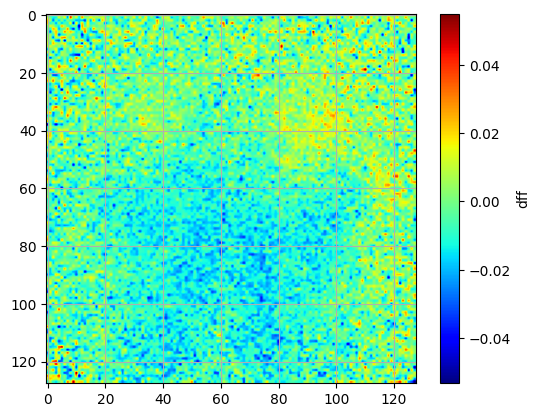

In [23]:
#plot of spatial signal without spatial smoothing
non_smoothed = plot_frame(dff_signal, frame_number, cmap = "jet", color_label = "dff")

#### 6A.2: spatial smoothing applied (gaussian, 3 pixels)

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/128 [00:00<00:40,  3.13it/s]

  2%|█▎                                                                                | 2/128 [00:00<00:39,  3.22it/s]

  2%|█▉                                                                                | 3/128 [00:00<00:37,  3.33it/s]

  3%|██▌                                                                               | 4/128 [00:01<00:36,  3.37it/s]

  4%|███▏                                                                              | 5/128 [00:01<00:35,  3.44it/s]

  5%|███▊                                                                              | 6/128 [00:01<00:39,  3.06it/s]

  5%|████▍                                                                             | 7/128 [00:02<00:38,  3.16it/s]

  6%|█████▏                                                                            | 8/128 [00:02<00:38,  3.13it/s]

  7%|█████▊                                                                            | 9/128 [00:02<00:36,  3.27it/s]

  8%|██████▎                                                                          | 10/128 [00:03<00:35,  3.28it/s]

  9%|██████▉                                                                          | 11/128 [00:03<00:36,  3.24it/s]

  9%|███████▌                                                                         | 12/128 [00:03<00:36,  3.21it/s]

 10%|████████▏                                                                        | 13/128 [00:04<00:36,  3.17it/s]

 11%|████████▊                                                                        | 14/128 [00:04<00:36,  3.11it/s]

 12%|█████████▍                                                                       | 15/128 [00:04<00:36,  3.10it/s]

 12%|██████████▏                                                                      | 16/128 [00:05<00:36,  3.06it/s]

 13%|██████████▊                                                                      | 17/128 [00:05<00:34,  3.18it/s]

 14%|███████████▍                                                                     | 18/128 [00:05<00:34,  3.16it/s]

 15%|████████████                                                                     | 19/128 [00:05<00:34,  3.15it/s]

 16%|████████████▋                                                                    | 20/128 [00:06<00:33,  3.21it/s]

 16%|█████████████▎                                                                   | 21/128 [00:06<00:32,  3.33it/s]

 17%|█████████████▉                                                                   | 22/128 [00:06<00:32,  3.26it/s]

 18%|██████████████▌                                                                  | 23/128 [00:07<00:31,  3.34it/s]

 19%|███████████████▏                                                                 | 24/128 [00:07<00:31,  3.25it/s]

 20%|███████████████▊                                                                 | 25/128 [00:07<00:32,  3.20it/s]

 20%|████████████████▍                                                                | 26/128 [00:08<00:31,  3.28it/s]

 21%|█████████████████                                                                | 27/128 [00:08<00:29,  3.40it/s]

 22%|█████████████████▋                                                               | 28/128 [00:08<00:28,  3.46it/s]

 23%|██████████████████▎                                                              | 29/128 [00:08<00:29,  3.41it/s]

 23%|██████████████████▉                                                              | 30/128 [00:09<00:28,  3.47it/s]

 24%|███████████████████▌                                                             | 31/128 [00:09<00:27,  3.48it/s]

 25%|████████████████████▎                                                            | 32/128 [00:09<00:29,  3.31it/s]

 26%|████████████████████▉                                                            | 33/128 [00:10<00:28,  3.30it/s]

 27%|█████████████████████▌                                                           | 34/128 [00:10<00:27,  3.38it/s]

 27%|██████████████████████▏                                                          | 35/128 [00:10<00:26,  3.47it/s]

 28%|██████████████████████▊                                                          | 36/128 [00:10<00:26,  3.48it/s]

 29%|███████████████████████▍                                                         | 37/128 [00:11<00:26,  3.39it/s]

 30%|████████████████████████                                                         | 38/128 [00:11<00:27,  3.27it/s]

 30%|████████████████████████▋                                                        | 39/128 [00:11<00:26,  3.37it/s]

 31%|█████████████████████████▎                                                       | 40/128 [00:12<00:28,  3.14it/s]

 32%|█████████████████████████▉                                                       | 41/128 [00:12<00:26,  3.23it/s]

 33%|██████████████████████████▌                                                      | 42/128 [00:12<00:26,  3.24it/s]

 34%|███████████████████████████▏                                                     | 43/128 [00:13<00:25,  3.37it/s]

 34%|███████████████████████████▊                                                     | 44/128 [00:13<00:24,  3.48it/s]

 35%|████████████████████████████▍                                                    | 45/128 [00:13<00:23,  3.59it/s]

 36%|█████████████████████████████                                                    | 46/128 [00:13<00:23,  3.51it/s]

 37%|█████████████████████████████▋                                                   | 47/128 [00:14<00:22,  3.52it/s]

 38%|██████████████████████████████▍                                                  | 48/128 [00:14<00:24,  3.24it/s]

 38%|███████████████████████████████                                                  | 49/128 [00:14<00:24,  3.19it/s]

 39%|███████████████████████████████▋                                                 | 50/128 [00:15<00:25,  3.08it/s]

 40%|████████████████████████████████▎                                                | 51/128 [00:15<00:25,  3.06it/s]

 41%|████████████████████████████████▉                                                | 52/128 [00:15<00:24,  3.10it/s]

 41%|█████████████████████████████████▌                                               | 53/128 [00:16<00:24,  3.11it/s]

 42%|██████████████████████████████████▏                                              | 54/128 [00:16<00:23,  3.15it/s]

 43%|██████████████████████████████████▊                                              | 55/128 [00:16<00:24,  3.02it/s]

 44%|███████████████████████████████████▍                                             | 56/128 [00:17<00:25,  2.85it/s]

 45%|████████████████████████████████████                                             | 57/128 [00:17<00:24,  2.95it/s]

 45%|████████████████████████████████████▋                                            | 58/128 [00:17<00:22,  3.07it/s]

 46%|█████████████████████████████████████▎                                           | 59/128 [00:18<00:21,  3.15it/s]

 47%|█████████████████████████████████████▉                                           | 60/128 [00:18<00:21,  3.13it/s]

 48%|██████████████████████████████████████▌                                          | 61/128 [00:18<00:21,  3.16it/s]

 48%|███████████████████████████████████████▏                                         | 62/128 [00:19<00:20,  3.17it/s]

 49%|███████████████████████████████████████▊                                         | 63/128 [00:19<00:19,  3.28it/s]

 50%|████████████████████████████████████████▌                                        | 64/128 [00:19<00:20,  3.14it/s]

 51%|█████████████████████████████████████████▏                                       | 65/128 [00:20<00:19,  3.15it/s]

 52%|█████████████████████████████████████████▊                                       | 66/128 [00:20<00:20,  3.09it/s]

 52%|██████████████████████████████████████████▍                                      | 67/128 [00:20<00:19,  3.17it/s]

 53%|███████████████████████████████████████████                                      | 68/128 [00:21<00:19,  3.08it/s]

 54%|███████████████████████████████████████████▋                                     | 69/128 [00:21<00:18,  3.13it/s]

 55%|████████████████████████████████████████████▎                                    | 70/128 [00:21<00:17,  3.22it/s]

 55%|████████████████████████████████████████████▉                                    | 71/128 [00:21<00:17,  3.24it/s]

 56%|█████████████████████████████████████████████▌                                   | 72/128 [00:22<00:18,  3.06it/s]

 57%|██████████████████████████████████████████████▏                                  | 73/128 [00:22<00:18,  2.98it/s]

 58%|██████████████████████████████████████████████▊                                  | 74/128 [00:23<00:18,  2.95it/s]

 59%|███████████████████████████████████████████████▍                                 | 75/128 [00:23<00:17,  3.06it/s]

 59%|████████████████████████████████████████████████                                 | 76/128 [00:23<00:16,  3.13it/s]

 60%|████████████████████████████████████████████████▋                                | 77/128 [00:23<00:15,  3.20it/s]

 61%|█████████████████████████████████████████████████▎                               | 78/128 [00:24<00:15,  3.22it/s]

 62%|█████████████████████████████████████████████████▉                               | 79/128 [00:24<00:15,  3.23it/s]

 62%|██████████████████████████████████████████████████▋                              | 80/128 [00:24<00:15,  3.07it/s]

 63%|███████████████████████████████████████████████████▎                             | 81/128 [00:25<00:14,  3.13it/s]

 64%|███████████████████████████████████████████████████▉                             | 82/128 [00:25<00:14,  3.15it/s]

 65%|████████████████████████████████████████████████████▌                            | 83/128 [00:25<00:14,  3.13it/s]

 66%|█████████████████████████████████████████████████████▏                           | 84/128 [00:26<00:14,  3.08it/s]

 66%|█████████████████████████████████████████████████████▊                           | 85/128 [00:26<00:13,  3.19it/s]

 67%|██████████████████████████████████████████████████████▍                          | 86/128 [00:26<00:13,  3.20it/s]

 68%|███████████████████████████████████████████████████████                          | 87/128 [00:27<00:13,  3.11it/s]

 69%|███████████████████████████████████████████████████████▋                         | 88/128 [00:27<00:13,  3.06it/s]

 70%|████████████████████████████████████████████████████████▎                        | 89/128 [00:27<00:12,  3.14it/s]

 70%|████████████████████████████████████████████████████████▉                        | 90/128 [00:28<00:11,  3.26it/s]

 71%|█████████████████████████████████████████████████████████▌                       | 91/128 [00:28<00:10,  3.36it/s]

 72%|██████████████████████████████████████████████████████████▏                      | 92/128 [00:28<00:10,  3.39it/s]

 73%|██████████████████████████████████████████████████████████▊                      | 93/128 [00:28<00:09,  3.51it/s]

 73%|███████████████████████████████████████████████████████████▍                     | 94/128 [00:29<00:09,  3.50it/s]

 74%|████████████████████████████████████████████████████████████                     | 95/128 [00:29<00:09,  3.50it/s]

 75%|████████████████████████████████████████████████████████████▊                    | 96/128 [00:29<00:09,  3.35it/s]

 76%|█████████████████████████████████████████████████████████████▍                   | 97/128 [00:30<00:10,  3.10it/s]

 77%|██████████████████████████████████████████████████████████████                   | 98/128 [00:30<00:09,  3.22it/s]

 77%|██████████████████████████████████████████████████████████████▋                  | 99/128 [00:30<00:08,  3.30it/s]

 78%|██████████████████████████████████████████████████████████████▌                 | 100/128 [00:31<00:08,  3.35it/s]

 79%|███████████████████████████████████████████████████████████████▏                | 101/128 [00:31<00:07,  3.44it/s]

 80%|███████████████████████████████████████████████████████████████▊                | 102/128 [00:31<00:07,  3.41it/s]

 80%|████████████████████████████████████████████████████████████████▍               | 103/128 [00:31<00:07,  3.40it/s]

 81%|█████████████████████████████████████████████████████████████████               | 104/128 [00:32<00:07,  3.21it/s]

 82%|█████████████████████████████████████████████████████████████████▋              | 105/128 [00:32<00:07,  3.12it/s]

 83%|██████████████████████████████████████████████████████████████████▎             | 106/128 [00:32<00:06,  3.19it/s]

 84%|██████████████████████████████████████████████████████████████████▉             | 107/128 [00:33<00:06,  3.33it/s]

 84%|███████████████████████████████████████████████████████████████████▌            | 108/128 [00:33<00:05,  3.35it/s]

 85%|████████████████████████████████████████████████████████████████████▏           | 109/128 [00:33<00:05,  3.44it/s]

 86%|████████████████████████████████████████████████████████████████████▊           | 110/128 [00:34<00:05,  3.42it/s]

 87%|█████████████████████████████████████████████████████████████████████▍          | 111/128 [00:34<00:04,  3.45it/s]

 88%|██████████████████████████████████████████████████████████████████████          | 112/128 [00:34<00:04,  3.27it/s]

 88%|██████████████████████████████████████████████████████████████████████▋         | 113/128 [00:34<00:04,  3.24it/s]

 89%|███████████████████████████████████████████████████████████████████████▎        | 114/128 [00:35<00:04,  3.24it/s]

 90%|███████████████████████████████████████████████████████████████████████▉        | 115/128 [00:35<00:04,  3.24it/s]

 91%|████████████████████████████████████████████████████████████████████████▌       | 116/128 [00:35<00:03,  3.24it/s]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 117/128 [00:36<00:03,  3.21it/s]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 118/128 [00:36<00:03,  3.33it/s]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 119/128 [00:36<00:02,  3.36it/s]

 94%|███████████████████████████████████████████████████████████████████████████     | 120/128 [00:37<00:02,  3.28it/s]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 121/128 [00:37<00:02,  3.10it/s]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 122/128 [00:37<00:01,  3.09it/s]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 123/128 [00:38<00:01,  3.22it/s]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 124/128 [00:38<00:01,  3.14it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 125/128 [00:38<00:00,  3.19it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 126/128 [00:38<00:00,  3.24it/s]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 127/128 [00:39<00:00,  3.34it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:39<00:00,  3.23it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:39<00:00,  3.23it/s]

frame number 200 plotted


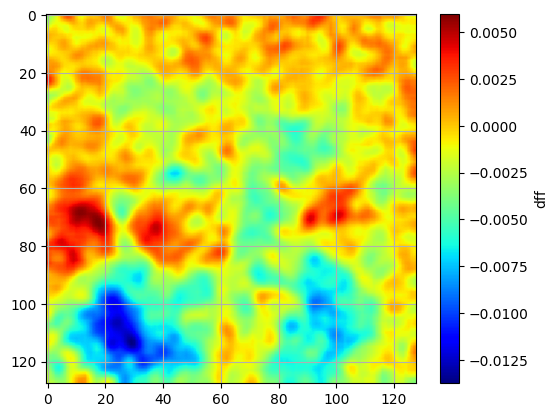

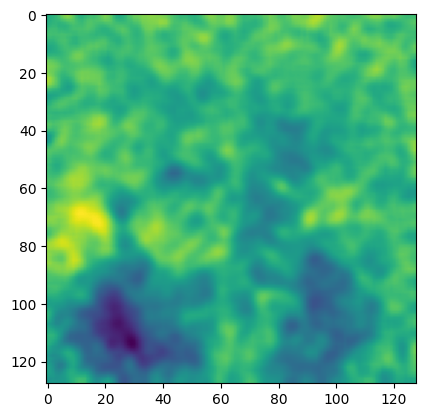

In [24]:
#plot of spatial resolution including spatial smoothing
smoothed_signal = smoothing(dff_signal)
plot_frame(smoothed_signal, 200, cmap = "jet", color_label = "dff")
plt.imshow(smoothed_signal[201])

### 6B: Temporal filtering

dff plot with chebyshev type 1 temporal filtering (high and low bandpass filter)

In [25]:
interactive_plot(smoothed_signal.mean(axis=(1,2)), title_label = "temporally smoothed signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 7: ROI plotting

### 7A: ROI full frame

plotting single flash full frame mean

In [26]:
full_roi_single, full_single_segments = avg_trials(single_indices, smoothed_signal, double=False, segment_size=200, minus=20)

In [27]:
interactive_plot(full_roi_single.mean(axis=(1,2)), title_label = "full frame single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash full frame mean

In [28]:
full_roi_double, full_double_segments = avg_trials(double_indices, smoothed_signal, double=True, segment_size=200, minus=20)

In [29]:
interactive_plot(full_roi_double.mean(axis=(1,2)), title_label = "full frame double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting NOGO full frame mean

Need to import the text file to know the location of the nogo trials

In [30]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

successfully loaded txt file


In [31]:
nogo_trials = extract_nogo(txt_file)

# nogo trials: 23


plotting nogo trials

In [32]:
full_roi_nogo, full_nogo_segments = avg_trials(nogo_trials, smoothed_signal, double=False, segment_size=200, minus=20)

In [33]:
interactive_plot(full_roi_nogo.mean(axis=(1,2)), title_label = "full frame NOGO average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

### 7B: V1 ROI

within all of v1 area at the back of the cortex the peak value at 5 frames is taken as the central point and a 15x15 grid is placed around the peak value

plotting single flash just v1 10x10 mean

In [34]:
v1_area_single = extract_v1(full_roi_single, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [35]:
interactive_plot(v1_area_single.mean(axis=(1,2)), title_label = "v1 single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash just v1 10x10 mean

In [36]:
v1_area_double = extract_v1(full_roi_double, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [37]:
interactive_plot(v1_area_double.mean(axis=(1,2)), title_label = "v1 double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 8: Line up to txt file and success vs fail rate

#### Step 8A: load in txt file from Pi_data folder

In [38]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

#extract single, double or nogo columns from the txt file
single_txt, double_txt, nogo_txt = extract_success(txt_file)

successfully loaded txt file


#### Step 8B: take the dff signal and sort them into arrays based on success or fail

In [39]:
single_success, single_fail = sort_success(single_txt, full_single_segments)

success = 29
fail = 3
total trials = 32


In [40]:
double_success, double_fail = sort_success(double_txt, full_double_segments)

success = 4
fail = 41
total trials = 45


In [41]:
nogo_success, nogo_fail = sort_success(nogo_txt, full_nogo_segments)

success = 9
fail = 14
total trials = 23


## Step 9: Save the 3D array as a TIFF stack

In [42]:
save_tiff(smoothed_signal, tiff_path_full) # full frame whole session tiff stack
save_tiff(full_roi_single, tiff_path_single) #SINGLE flash averaged response over all trials tiff stack file name to save
save_tiff(full_roi_double, tiff_path_double) #DOUBLE flash averaged response over all trials tiff stack file name to save

  0%|                                                                                        | 0/34374 [00:00<?, ?it/s]

  8%|█████▊                                                                    | 2719/34374 [00:00<00:01, 26929.93it/s]

 16%|███████████▋                                                              | 5412/34374 [00:00<00:01, 22909.05it/s]

 23%|█████████████████                                                         | 7920/34374 [00:00<00:01, 23716.74it/s]

 30%|█████████████████████▉                                                   | 10320/34374 [00:00<00:01, 22971.25it/s]

 38%|███████████████████████████▌                                             | 12950/34374 [00:00<00:00, 24020.05it/s]

 45%|████████████████████████████████▋                                        | 15375/34374 [00:00<00:00, 24019.36it/s]

 52%|██████████████████████████████████████                                   | 17917/34374 [00:00<00:00, 24388.28it/s]

 59%|███████████████████████████████████████████▏                             | 20365/34374 [00:00<00:00, 23125.95it/s]

 67%|████████████████████████████████████████████████▋                        | 22934/34374 [00:00<00:00, 23816.92it/s]

 74%|█████████████████████████████████████████████████████▉                   | 25419/34374 [00:01<00:00, 24054.37it/s]

 81%|███████████████████████████████████████████████████████████              | 27836/34374 [00:01<00:00, 23738.79it/s]

 88%|████████████████████████████████████████████████████████████████▏        | 30218/34374 [00:01<00:00, 23419.86it/s]

 95%|█████████████████████████████████████████████████████████████████████▌   | 32763/34374 [00:01<00:00, 23947.53it/s]

100%|█████████████████████████████████████████████████████████████████████████| 34374/34374 [00:01<00:00, 23862.35it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 28583.24it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 25007.77it/s]

Combined TIFF stack saved successfully.


### Step 9B: Pickle for uploading into other scripts

In [43]:
# Now you can use these file paths in your code
with open(pickle_single_v1, 'wb') as f:
    pickle.dump(v1_area_single, f)

with open(pickle_double_v1, 'wb') as f:
    pickle.dump(v1_area_double, f)

with open(pickle_single_success_ff, 'wb') as f:
    pickle.dump(single_success, f)

with open(pickle_single_fail_ff, 'wb') as f:
    pickle.dump(single_fail, f)

with open(pickle_double_success_ff, 'wb') as f:
    pickle.dump(double_success, f)

with open(pickle_double_fail_ff, 'wb') as f:
    pickle.dump(double_fail, f)

with open(pickle_nogo_success_ff, 'wb') as f:
    pickle.dump(nogo_success, f)

with open(pickle_nogo_fail_ff, 'wb') as f:
    pickle.dump(nogo_fail, f)

# Mask and animate figures

#### currently not using these, good for visualization and flair

In [44]:
#masking = load_masks(dff_signal)
#mask, mask_outline = masking[0], masking[1]

#masked_smoothed_signal = smoothed_signal*mask
#masked_full_roi_single = full_roi_single*mask
#masked_full_roi_double = full_roi_double*mask

In [45]:
#file_path_ = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts.tiff"
#save_tiff(masked_smoothed_signal, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_single.tiff"
#save_tiff(masked_full_roi_single, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_double.tiff"
#save_tiff(masked_full_roi_double, file_path)

#print(f"TIFF stack saved at: {file_path}")